In [ ]:
!pip install pmdarima
!pip install arch
!pip install pytorch-lightning==1.9.5
!pip install tqdm==4.66.4
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping
from pytorch_lightning.loggers import TensorBoardLogger
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.autograd as autograd
import torch.optim as optimal_lags
from torch.utils.data import Dataset, DataLoader
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.arima.model import ARIMA
import statsmodels.tsa.statespace.sarimax
import pmdarima as pm
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
from sklearn.preprocessing import MinMaxScaler
import statsmodels.api as sm
from tqdm.notebook import tqdm
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller, acf, pacf, q_stat
from statsmodels.stats.diagnostic import acorr_ljungbox, acorr_breusch_godfrey
from arch.unitroot import PhillipsPerron
device = 'cuda:0' if torch.cuda.is_available() else 'cpu'
device

'cpu'

In [ ]:
import pandas as pd

# Romanian to month number mapping
romanian_to_month = {
    "Ianuarie": "01",
    "Februarie": "02",
    "Martie": "03",
    "Aprilie": "04",
    "Mai": "05",
    "Iunie": "06",
    "Iulie": "07",
    "August": "08",
    "Septembrie": "09",
    "Octombrie": "10",
    "Noiembrie": "11",
    "Decembrie": "12"
}

# Function to convert Romanian month names to 'YYYY-MM' format
def convert_to_date_format(date_str):
    month_name, year = date_str.split()
    month_number = romanian_to_month[month_name]
    return f"{year}-{month_number}-01"  # Start of the month

# Load the data
somaj = pd.read_csv('Somaj Romania.csv')

# Apply the conversion function to the 'T' column
somaj['T'] = somaj['T'].apply(convert_to_date_format)

# Convert the 'T' column to datetime format
somaj['T'] = pd.to_datetime(somaj['T'], format='%Y-%m-%d')

# Display the updated dataframe
print(somaj.head(5))

# Load the inflatie data
inflatie = pd.read_csv('Inflatie Romania.csv')

# Apply the conversion function to the 'T' column
inflatie['T'] = inflatie['T'].apply(convert_to_date_format)

# Convert the 'T' column to datetime format
inflatie['T'] = pd.to_datetime(inflatie['T'], format='%Y-%m-%d')

# Display the updated dataframe
print(inflatie.head(5))

# Set index to 'T'
somaj.set_index("T", inplace=True)
inflatie.set_index("T", inplace=True)

# Convert dates to end of month
somaj.index = somaj.index + pd.offsets.MonthEnd(0)
inflatie.index = inflatie.index + pd.offsets.MonthEnd(0)

# Reindex to the monthly frequency, filling in missing dates if any
somaj = somaj.resample('M').asfreq()
inflatie = inflatie.resample('M').asfreq()

print(somaj.head(5))
print(inflatie.head(5))

# For rata_schimb data
# Load the rata_schimb data
rata_schimb = pd.read_csv('RON_USD.csv')

# Function to convert 'MMM-YY' format to 'YYYY-MM' format
def convert_month_year_format(date_str):
    month_abbr, year = date_str.split('-')
    month_number = pd.to_datetime(month_abbr, format='%b').month
    return f"20{year}-{month_number:02d}-01"  # '20' prefix assumes dates are in the 2000s

# Apply the conversion function to the 'Date' column
rata_schimb['Date'] = rata_schimb['Date'].apply(convert_month_year_format)

# Convert the 'Date' column to datetime format
rata_schimb['Date'] = pd.to_datetime(rata_schimb['Date'], format='%Y-%m-%d')

# Set index to 'Date'
rata_schimb.set_index("Date", inplace=True)

# Convert dates to end of month
rata_schimb.index = rata_schimb.index + pd.offsets.MonthEnd(0)

# Reindex to the monthly frequency, filling in missing dates if any
rata_schimb = rata_schimb.resample('M').asfreq()

# Display the updated dataframe

print(rata_schimb.head(5))

           T  Rata Somajului
0 2009-01-01             7.9
1 2009-02-01             8.2
2 2009-03-01             8.1
3 2009-04-01             8.1
4 2009-05-01             8.2
           T  HICP
0 2009-01-01   6.8
1 2009-02-01   6.9
2 2009-03-01   6.7
3 2009-04-01   6.4
4 2009-05-01   5.9
            Rata Somajului
T                         
2009-01-31             7.9
2009-02-28             8.2
2009-03-31             8.1
2009-04-30             8.1
2009-05-31             8.2
            HICP
T               
2009-01-31   6.8
2009-02-28   6.9
2009-03-31   6.7
2009-04-30   6.4
2009-05-31   5.9
            RON/USD
Date               
2009-01-31   3.1999
2009-02-28   3.3480
2009-03-31   3.2851
2009-04-30   3.1777
2009-05-31   3.0554


p-value of ADF test: 0.8396218890302761
Ljung-Box test:
        lb_stat  lb_pvalue
10  1660.259096        0.0
Box-Pierce test:
Q-statistic: 1855.6751160963809, p-value: 0.0
Phillips-Perron test:
     Phillips-Perron Test (Z-tau)    
Test Statistic                 -0.591
P-value                         0.873
Lags                               14
-------------------------------------

Trend: Constant
Critical Values: -3.47 (1%), -2.88 (5%), -2.58 (10%)
Null Hypothesis: The process contains a unit root.
Alternative Hypothesis: The process is weakly stationary.
(0.20624334952591217, 0.013658743927782937, 9, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})


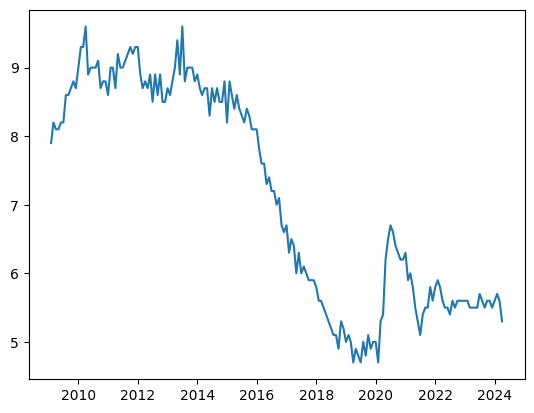

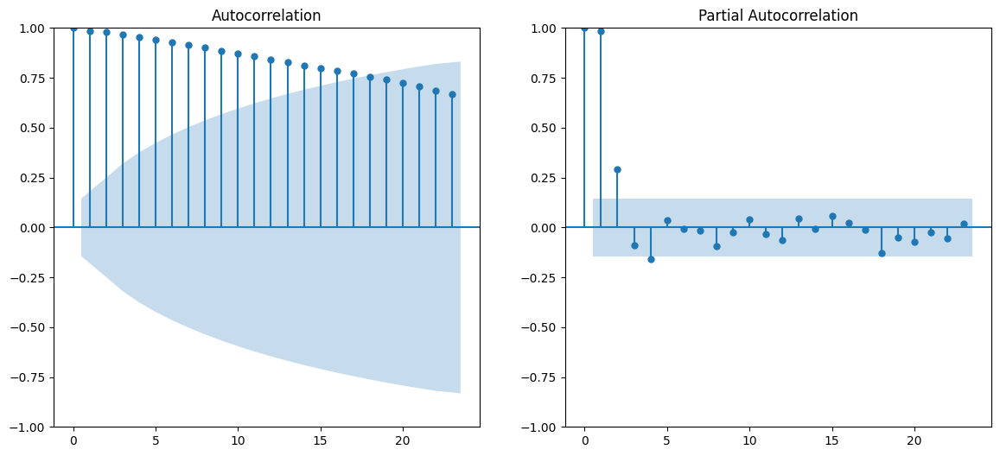

In [ ]:
plt.plot(somaj)

fig, axes = plt.subplots(1, 2, figsize=(14, 6))

plot_acf(somaj['Rata Somajului'], ax=axes[0])

plot_pacf(somaj['Rata Somajului'], ax=axes[1])

adf_test = adfuller(somaj['Rata Somajului'])
print(f'p-value of ADF test: {adf_test[1]}')

# Ljung-Box test
ljung_box_test = acorr_ljungbox(somaj, lags=[10], return_df=True)
print('Ljung-Box test:')
print(ljung_box_test)

# Box-Pierce test
box_pierce_test = q_stat(acf(somaj, nlags=10), len(somaj))
print('Box-Pierce test:')
print(f'Q-statistic: {box_pierce_test[0][-1]}, p-value: {box_pierce_test[1][-1]}')

# Phillips-Perron test
pp_test = PhillipsPerron(somaj)
print('Phillips-Perron test:')
print(pp_test)
#kpss = KPSS()
#print(kpss.summary().as_text())
print(sm.tsa.stattools.kpss(somaj, regression='ct'))

p-value of ADF test: 0.8316571039192445
Ljung-Box test:
        lb_stat      lb_pvalue
10  1270.718375  7.972883e-267
Box-Pierce test:
Q-statistic: 1463.9043138413424, p-value: 1.9552719446346254e-307
Phillips-Perron test:
     Phillips-Perron Test (Z-tau)    
Test Statistic                 -1.876
P-value                         0.344
Lags                               14
-------------------------------------

Trend: Constant
Critical Values: -3.47 (1%), -2.88 (5%), -2.58 (10%)
Null Hypothesis: The process contains a unit root.
Alternative Hypothesis: The process is weakly stationary.
(0.3472540038567827, 0.01, 9, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})


<ipython-input-6-7b14005661e6>:27: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  print(sm.tsa.stattools.kpss(inflatie, regression='ct'))


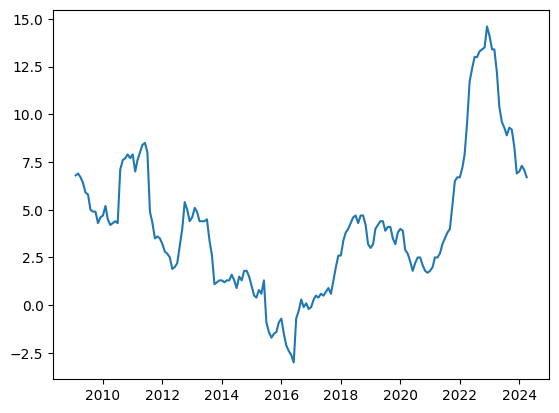

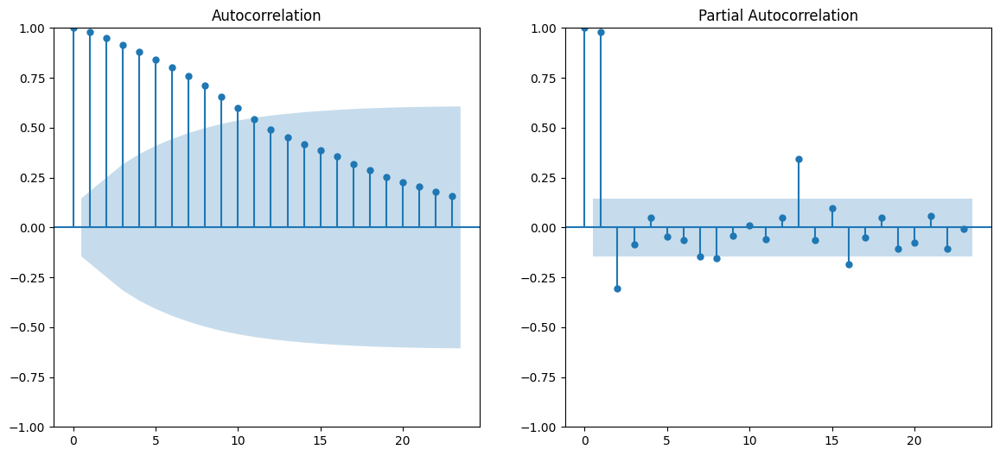

In [ ]:
plt.plot(inflatie)
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

plot_acf(inflatie['HICP'], ax=axes[0])

plot_pacf(inflatie['HICP'], ax=axes[1])

adf_test = adfuller(inflatie['HICP'])
print(f'p-value of ADF test: {adf_test[1]}')

# Ljung-Box test
ljung_box_test = acorr_ljungbox(inflatie, lags=[10], return_df=True)
print('Ljung-Box test:')
print(ljung_box_test)

# Box-Pierce test
box_pierce_test = q_stat(acf(inflatie, nlags=10), len(inflatie))
print('Box-Pierce test:')
print(f'Q-statistic: {box_pierce_test[0][-1]}, p-value: {box_pierce_test[1][-1]}')

# Phillips-Perron test
pp_test = PhillipsPerron(inflatie)
print('Phillips-Perron test:')
print(pp_test)
#kpss = KPSS()
#print(kpss.summary().as_text())
print(sm.tsa.stattools.kpss(inflatie, regression='ct'))

p-value of ADF test: 0.7267331840997217
Ljung-Box test:
        lb_stat      lb_pvalue
10  1423.772248  7.305655e-300
Box-Pierce test:
Q-statistic: 1617.8357625205726, p-value: 0.0
Phillips-Perron test:
     Phillips-Perron Test (Z-tau)    
Test Statistic                 -0.969
P-value                         0.765
Lags                               14
-------------------------------------

Trend: Constant
Critical Values: -3.47 (1%), -2.88 (5%), -2.58 (10%)
Null Hypothesis: The process contains a unit root.
Alternative Hypothesis: The process is weakly stationary.
(0.0764200305029387, 0.1, 8, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})


<ipython-input-7-893c85e16923>:28: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  print(sm.tsa.stattools.kpss(rata_schimb, regression='ct'))


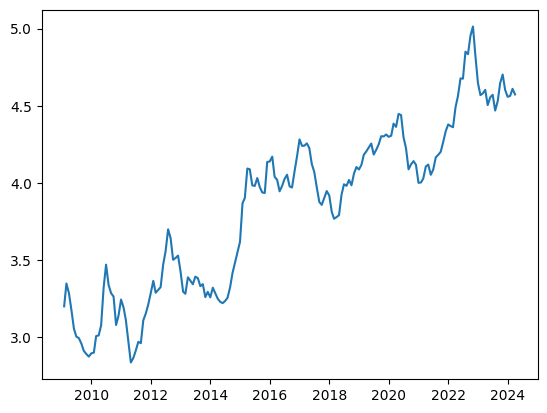

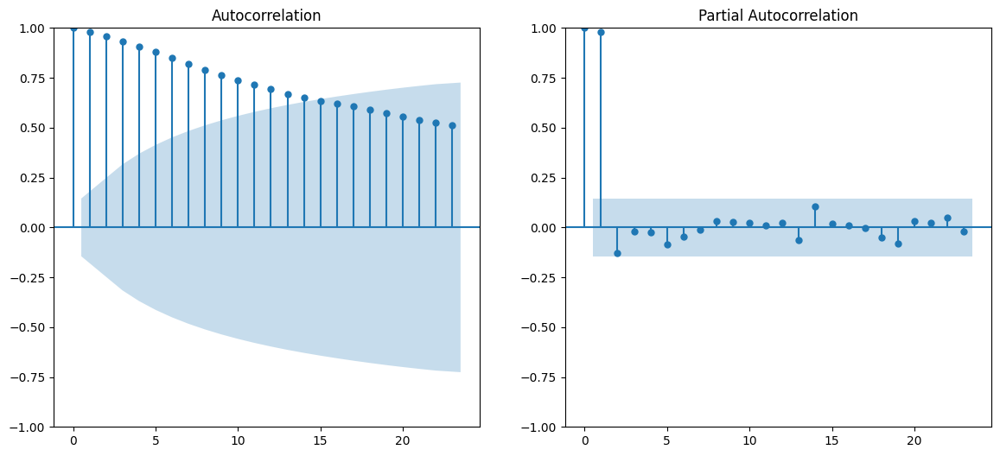

In [ ]:
plt.plot(rata_schimb)
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

plot_acf(rata_schimb, ax=axes[0])

plot_pacf(rata_schimb, ax=axes[1])


adf_test = adfuller(rata_schimb)
print(f'p-value of ADF test: {adf_test[1]}')

# Ljung-Box test
ljung_box_test = acorr_ljungbox(rata_schimb, lags=[10], return_df=True)
print('Ljung-Box test:')
print(ljung_box_test)

# Box-Pierce test
box_pierce_test = q_stat(acf(rata_schimb, nlags=10), len(inflatie))
print('Box-Pierce test:')
print(f'Q-statistic: {box_pierce_test[0][-1]}, p-value: {box_pierce_test[1][-1]}')

# Phillips-Perron test
pp_test = PhillipsPerron(rata_schimb)
print('Phillips-Perron test:')
print(pp_test)
#kpss = KPSS()
#print(kpss.summary().as_text())
print(sm.tsa.stattools.kpss(rata_schimb, regression='ct'))

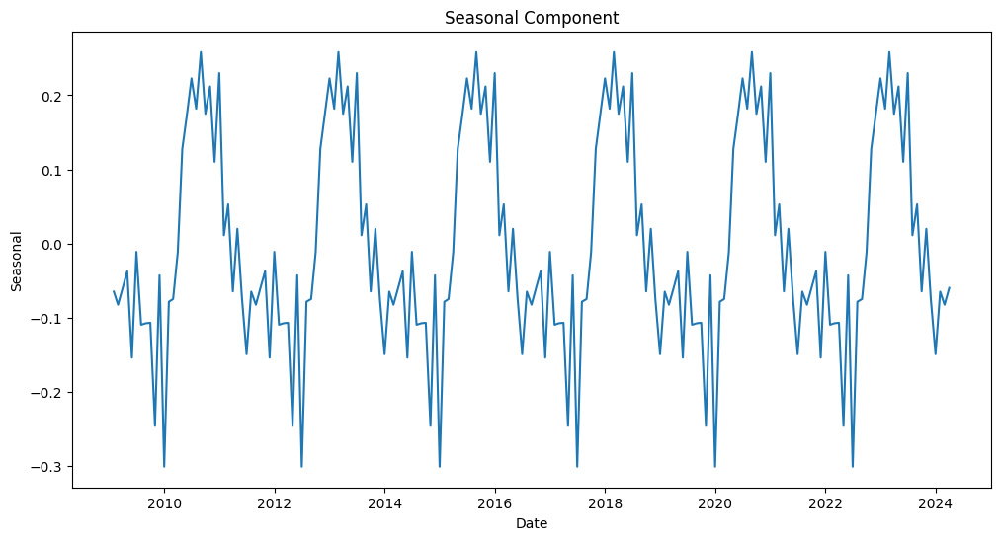

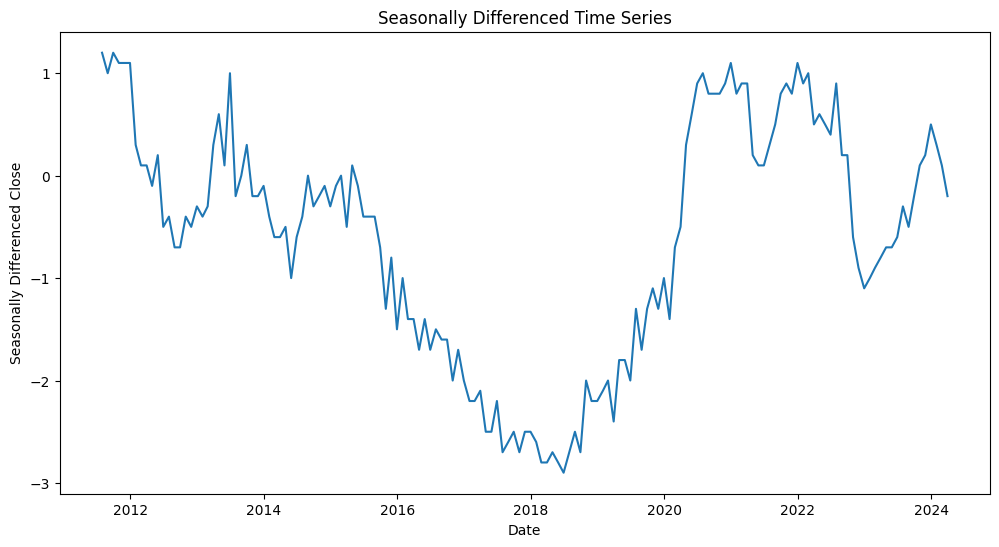

p-value of ADF test: 0.31459012882833853
Ljung-Box test:
       lb_stat      lb_pvalue
10  980.240565  3.373004e-204
Box-Pierce test:
Q-statistic: 1142.9170477316572, p-value: 3.233838053999123e-238
Phillips-Perron test:
     Phillips-Perron Test (Z-tau)    
Test Statistic                 -2.177
P-value                         0.215
Lags                               14
-------------------------------------

Trend: Constant
Critical Values: -3.47 (1%), -2.88 (5%), -2.58 (10%)
Null Hypothesis: The process contains a unit root.
Alternative Hypothesis: The process is weakly stationary.
(0.3067867351802525, 0.01, 8, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})


<ipython-input-8-852e513d2106>:45: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  print(sm.tsa.stattools.kpss(seasonal_diff, regression='ct'))


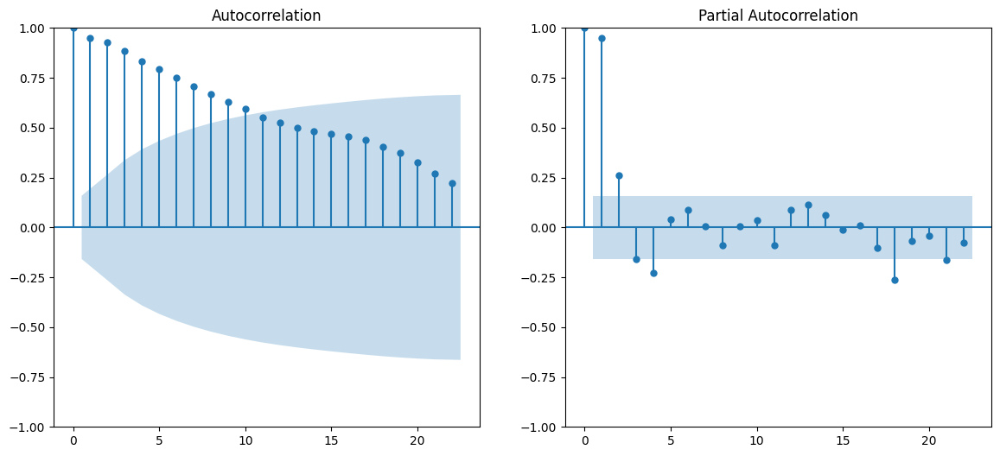

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose
result = seasonal_decompose(somaj['Rata Somajului'], model='additive', period=30)

seasonal = result.seasonal
plt.figure(figsize=(12, 6))
plt.plot(seasonal)
plt.title('Seasonal Component')
plt.xlabel('Date')
plt.ylabel('Seasonal')
plt.show()

seasonal_diff = somaj['Rata Somajului'].diff(30).dropna()
plt.figure(figsize=(12, 6))
plt.plot(seasonal_diff)
plt.title('Seasonally Differenced Time Series')
plt.xlabel('Date')
plt.ylabel('Seasonally Differenced Close')
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(14, 6))

plot_acf(seasonal_diff, ax=axes[0])

plot_pacf(seasonal_diff, ax=axes[1])

adf_test = adfuller(seasonal_diff)
print(f'p-value of ADF test: {adf_test[1]}')

# Ljung-Box test
ljung_box_test = acorr_ljungbox(seasonal_diff, lags=[10], return_df=True)
print('Ljung-Box test:')
print(ljung_box_test)

# Box-Pierce test
box_pierce_test = q_stat(acf(seasonal_diff, nlags=10), len(seasonal_diff))
print('Box-Pierce test:')
print(f'Q-statistic: {box_pierce_test[0][-1]}, p-value: {box_pierce_test[1][-1]}')

# Phillips-Perron test
pp_test = PhillipsPerron(seasonal_diff)
print('Phillips-Perron test:')
print(pp_test)
#kpss = KPSS()
#print(kpss.summary().as_text())
print(sm.tsa.stattools.kpss(seasonal_diff, regression='ct'))

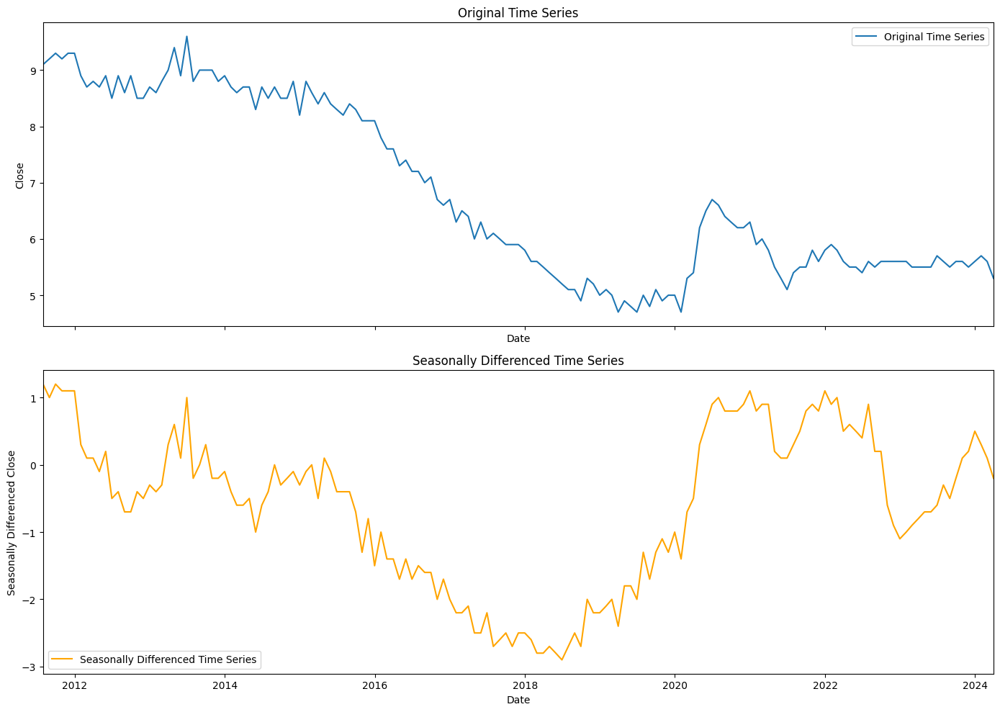

In [ ]:
fig, axes = plt.subplots(2, 1, figsize=(14, 10), sharex=True)

# Plot the original time series, adjusting to the date range of the seasonally adjusted series
axes[0].plot(somaj['Rata Somajului'], label='Original Time Series')
axes[0].set_xlim(seasonal_diff.index.min(), seasonal_diff.index.max())
axes[0].set_title('Original Time Series')
axes[0].set_xlabel('Date')
axes[0].set_ylabel('Close')
axes[0].legend()

# Plot the seasonally differenced time series
axes[1].plot(seasonal_diff, label='Seasonally Differenced Time Series', color='orange')
axes[1].set_title('Seasonally Differenced Time Series')
axes[1].set_xlabel('Date')
axes[1].set_ylabel('Seasonally Differenced Close')
axes[1].legend()
# Adjust layout
plt.tight_layout()
plt.show()

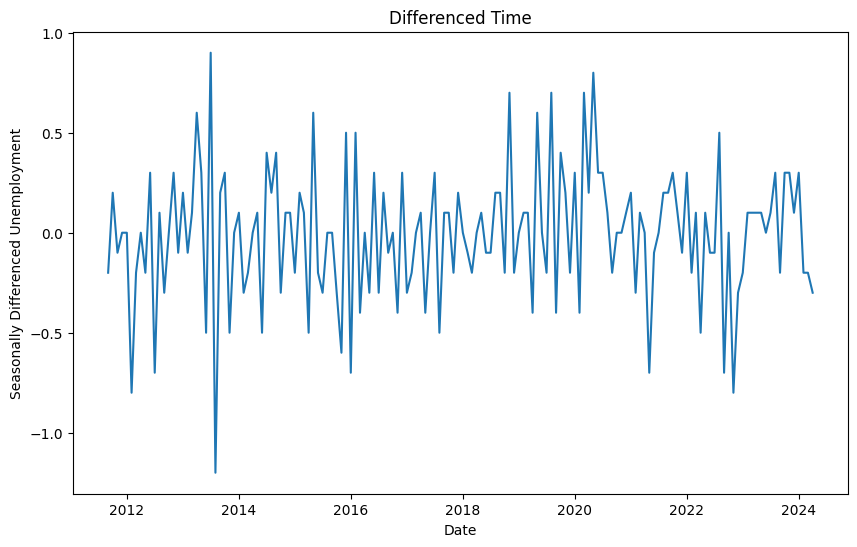

p-value: 0.003548683315580934
Ljung-Box test:
     lb_stat  lb_pvalue
10  31.08663   0.000568
Box-Pierce test:
Q-statistic: 186.31528496876797, p-value: 5.082013187159346e-34
Phillips-Perron test:
     Phillips-Perron Test (Z-tau)    
Test Statistic                -16.307
P-value                         0.000
Lags                               14
-------------------------------------

Trend: Constant
Critical Values: -3.47 (1%), -2.88 (5%), -2.58 (10%)
Null Hypothesis: The process contains a unit root.
Alternative Hypothesis: The process is weakly stationary.
(0.08192519729069149, 0.1, 5, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})


<ipython-input-10-feeeff74489f>:36: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  print(sm.tsa.stattools.kpss(diff_df, regression='ct'))


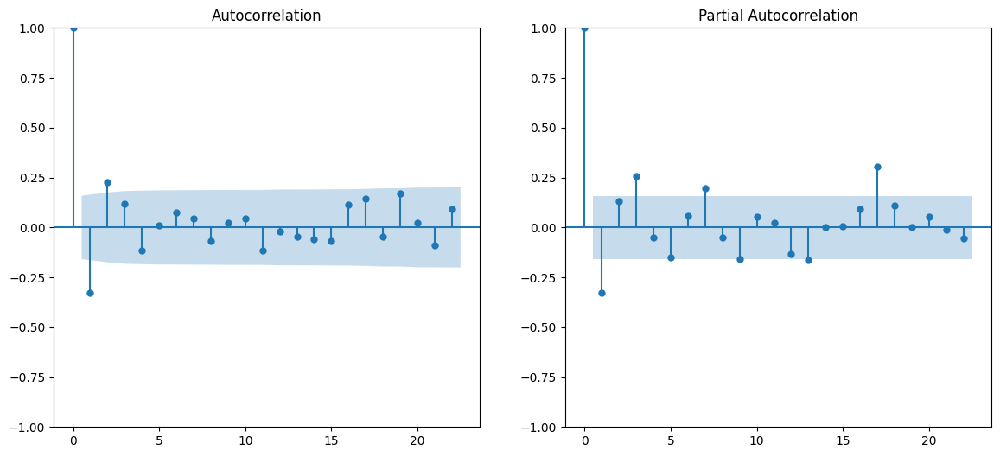

In [ ]:
diff_df = seasonal_diff.diff().dropna()

plt.figure(figsize=(10, 6))
plt.plot(diff_df)
plt.title('Differenced Time')
plt.xlabel('Date')
plt.ylabel('Seasonally Differenced Unemployment')
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(14, 6))

plot_acf(diff_df, ax=axes[0])

plot_pacf(diff_df, ax=axes[1])

adf_test = adfuller(diff_df)

print(f'p-value: {adf_test[1]}')

# Ljung-Box test
ljung_box_test = acorr_ljungbox(diff_df, lags=[10], return_df=True)
print('Ljung-Box test:')
print(ljung_box_test)

# Box-Pierce test
box_pierce_test = q_stat(acf(diff_df, nlags=10), len(diff_df))
print('Box-Pierce test:')
print(f'Q-statistic: {box_pierce_test[0][-1]}, p-value: {box_pierce_test[1][-1]}')

# Phillips-Perron test
pp_test = PhillipsPerron(diff_df)
print('Phillips-Perron test:')
print(pp_test)
#kpss = KPSS()
#print(kpss.summary().as_text())
print(sm.tsa.stattools.kpss(diff_df, regression='ct'))

#Seria Somaj e integrabila de ordin 1

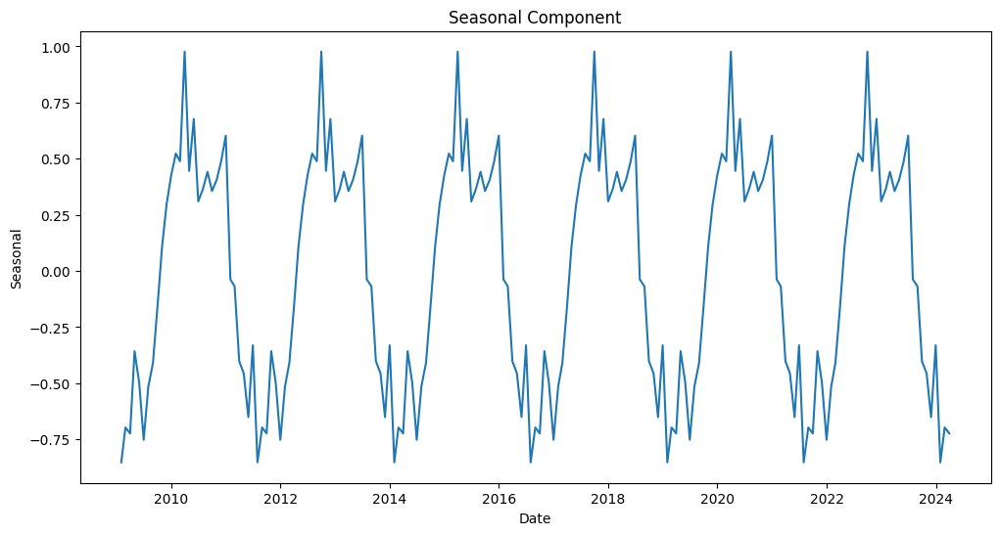

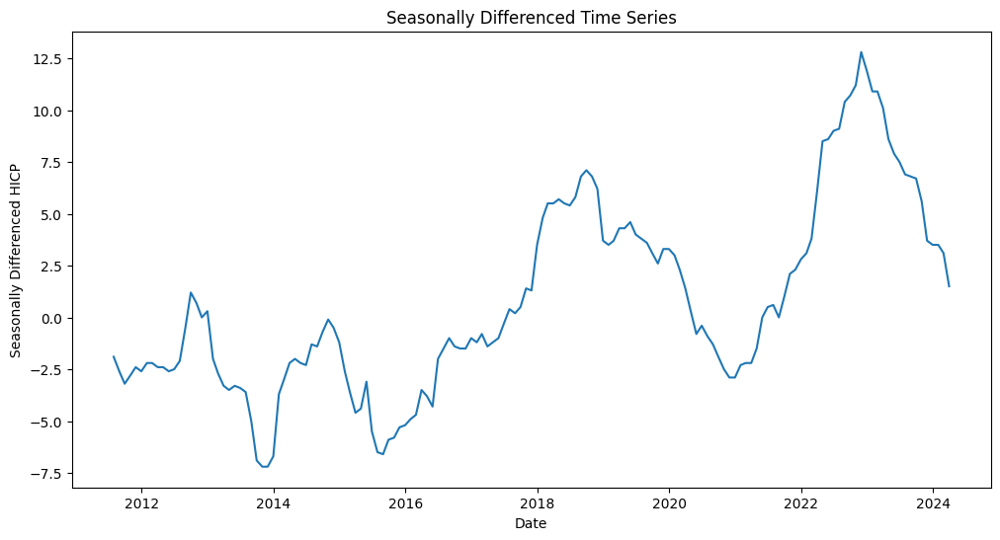

p-value: 0.5260559601581792
Ljung-Box test:
        lb_stat      lb_pvalue
10  1012.589289  3.629692e-211
Box-Pierce test:
Q-statistic: 1175.4796222732957, p-value: 3.116389094035975e-245
Phillips-Perron test:
     Phillips-Perron Test (Z-tau)    
Test Statistic                 -1.887
P-value                         0.338
Lags                               14
-------------------------------------

Trend: Constant
Critical Values: -3.47 (1%), -2.88 (5%), -2.58 (10%)
Null Hypothesis: The process contains a unit root.
Alternative Hypothesis: The process is weakly stationary.
(0.07922856598308958, 0.1, 8, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})


<ipython-input-11-366e24a39131>:46: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  print(sm.tsa.stattools.kpss(seasonal_diff, regression='ct'))


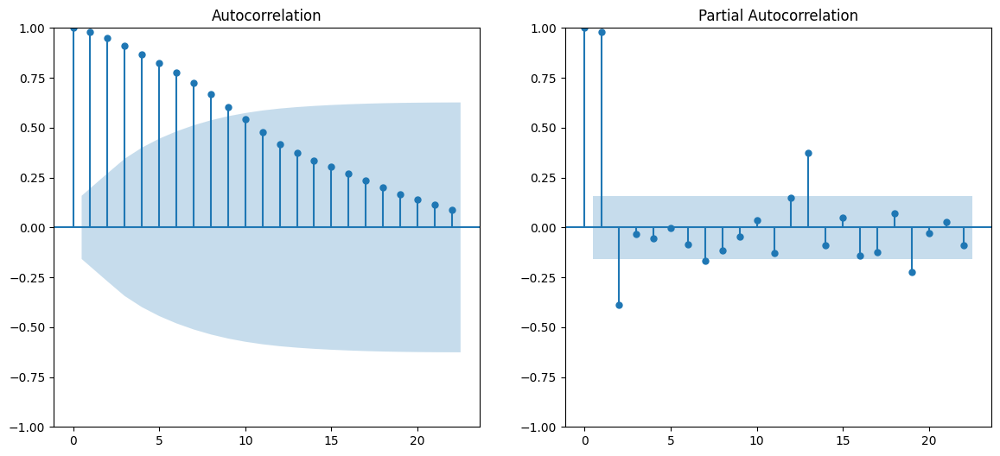

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose
result = seasonal_decompose(inflatie['HICP'], model='additive', period=30)

seasonal = result.seasonal
plt.figure(figsize=(12, 6))
plt.plot(seasonal)
plt.title('Seasonal Component')
plt.xlabel('Date')
plt.ylabel('Seasonal')
plt.show()

seasonal_diff = inflatie['HICP'].diff(30).dropna()
plt.figure(figsize=(12, 6))
plt.plot(seasonal_diff)
plt.title('Seasonally Differenced Time Series')
plt.xlabel('Date')
plt.ylabel('Seasonally Differenced HICP')
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(14, 6))

plot_acf(seasonal_diff, ax=axes[0])

plot_pacf(seasonal_diff, ax=axes[1])

adf_test = adfuller(seasonal_diff)

print(f'p-value: {adf_test[1]}')

# Ljung-Box test
ljung_box_test = acorr_ljungbox(seasonal_diff, lags=[10], return_df=True)
print('Ljung-Box test:')
print(ljung_box_test)

# Box-Pierce test
box_pierce_test = q_stat(acf(seasonal_diff, nlags=10), len(seasonal_diff))
print('Box-Pierce test:')
print(f'Q-statistic: {box_pierce_test[0][-1]}, p-value: {box_pierce_test[1][-1]}')

# Phillips-Perron test
pp_test = PhillipsPerron(seasonal_diff)
print('Phillips-Perron test:')
print(pp_test)
#kpss = KPSS()
#print(kpss.summary().as_text())
print(sm.tsa.stattools.kpss(seasonal_diff, regression='ct'))

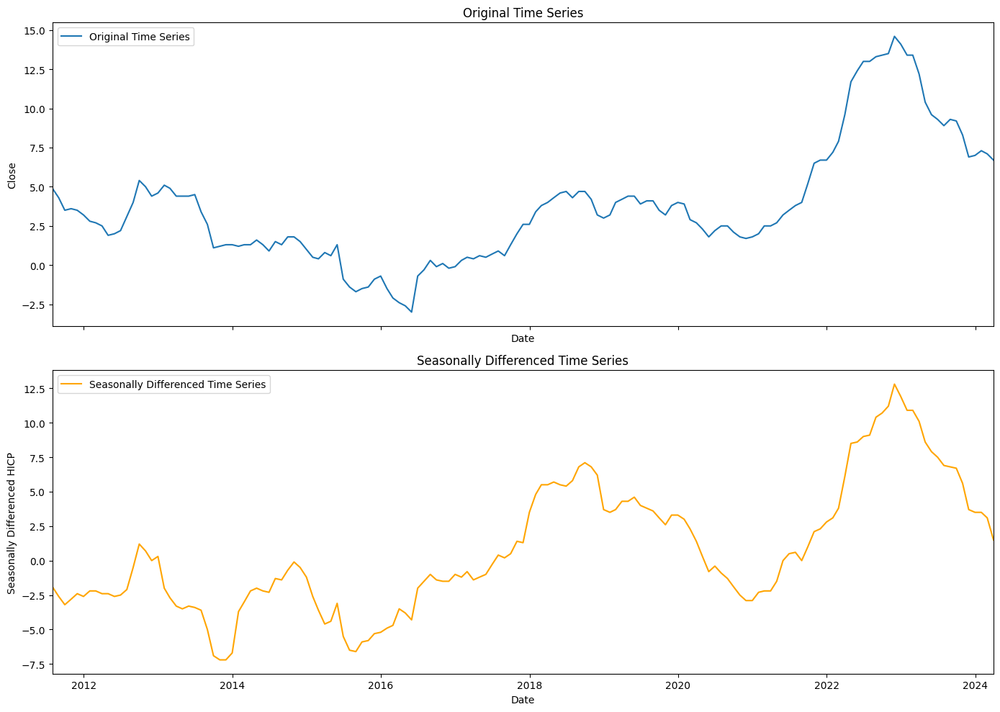

In [ ]:
fig, axes = plt.subplots(2, 1, figsize=(14, 10), sharex=True)

# Plot the original time series, adjusting to the date range of the seasonally adjusted series
axes[0].plot(inflatie['HICP'], label='Original Time Series')
axes[0].set_xlim(seasonal_diff.index.min(), seasonal_diff.index.max())
axes[0].set_title('Original Time Series')
axes[0].set_xlabel('Date')
axes[0].set_ylabel('Close')
axes[0].legend()

# Plot the seasonally differenced time series
axes[1].plot(seasonal_diff, label='Seasonally Differenced Time Series', color='orange')
axes[1].set_title('Seasonally Differenced Time Series')
axes[1].set_xlabel('Date')
axes[1].set_ylabel('Seasonally Differenced HICP')
axes[1].legend()
# Adjust layout
plt.tight_layout()
plt.show()

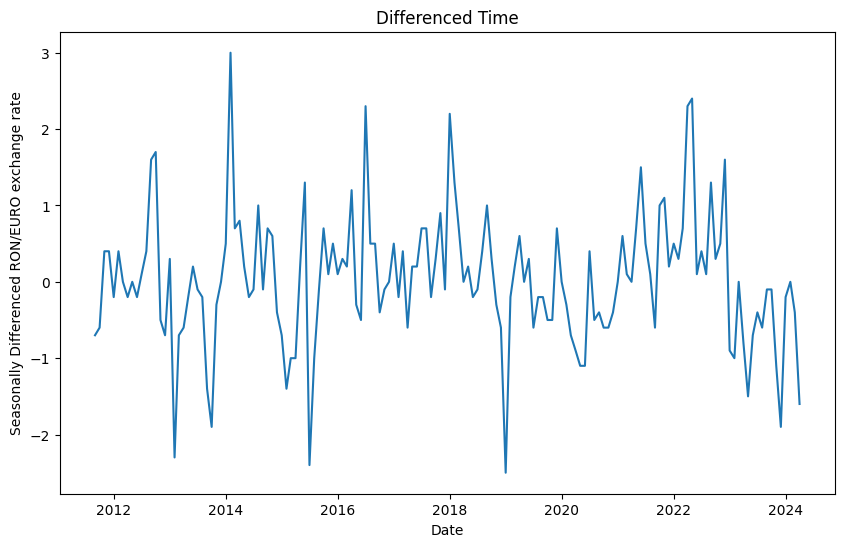

p-value: 0.0029811259943744706
Ljung-Box test:
      lb_stat  lb_pvalue
10  38.519657   0.000031
Box-Pierce test:
Q-statistic: 193.79991097521363, p-value: 1.4351964733358404e-35
Phillips-Perron test:
     Phillips-Perron Test (Z-tau)    
Test Statistic                 -8.435
P-value                         0.000
Lags                               14
-------------------------------------

Trend: Constant
Critical Values: -3.47 (1%), -2.88 (5%), -2.58 (10%)
Null Hypothesis: The process contains a unit root.
Alternative Hypothesis: The process is weakly stationary.
(0.07346885053497601, 0.1, 5, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})


<ipython-input-13-ce571138e53c>:38: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  print(sm.tsa.stattools.kpss(diff_df, regression='ct'))


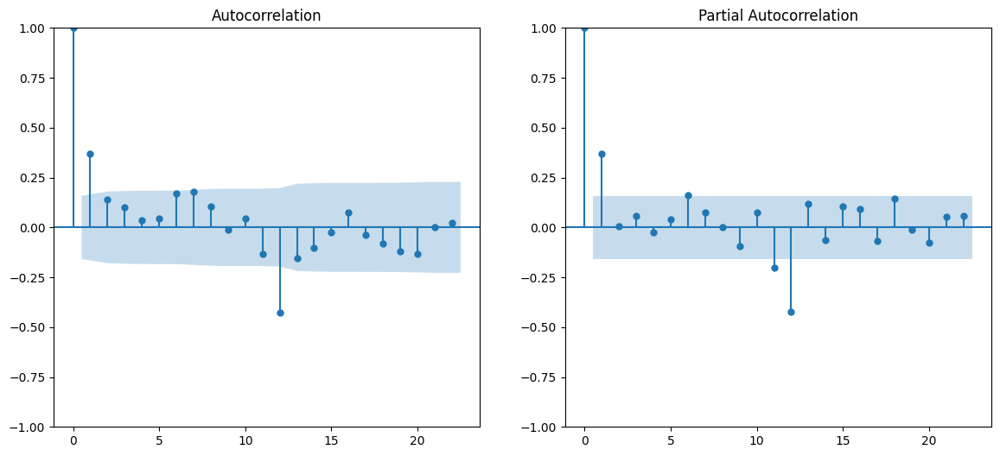

In [ ]:
diff_df = seasonal_diff.diff().dropna()

plt.figure(figsize=(10, 6))
plt.plot(diff_df)
plt.title('Differenced Time')
plt.xlabel('Date')
plt.ylabel('Seasonally Differenced RON/EURO exchange rate')
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(14, 6))

plot_acf(diff_df, ax=axes[0])

plot_pacf(diff_df, ax=axes[1])

adf_test = adfuller(diff_df)

print(f'p-value: {adf_test[1]}')

#Seria Inflatie e integrabila de ordin 1

# Ljung-Box test
ljung_box_test = acorr_ljungbox(diff_df, lags=[10], return_df=True)
print('Ljung-Box test:')
print(ljung_box_test)

# Box-Pierce test
box_pierce_test = q_stat(acf(diff_df, nlags=10), len(diff_df))
print('Box-Pierce test:')
print(f'Q-statistic: {box_pierce_test[0][-1]}, p-value: {box_pierce_test[1][-1]}')

# Phillips-Perron test
pp_test = PhillipsPerron(diff_df)
print('Phillips-Perron test:')
print(pp_test)
#kpss = KPSS()
#print(kpss.summary().as_text())
print(sm.tsa.stattools.kpss(diff_df, regression='ct'))

#Seria Somaj e integrabila de ordin 1

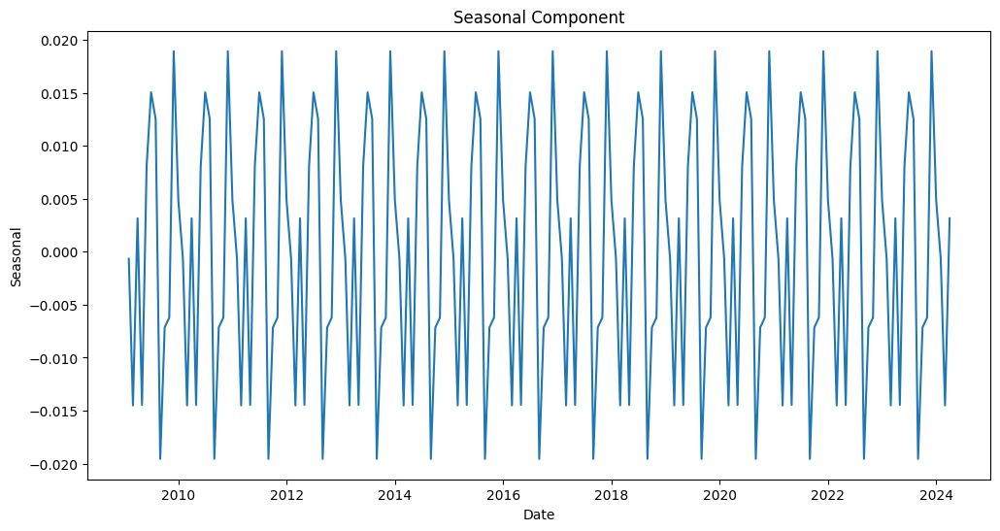

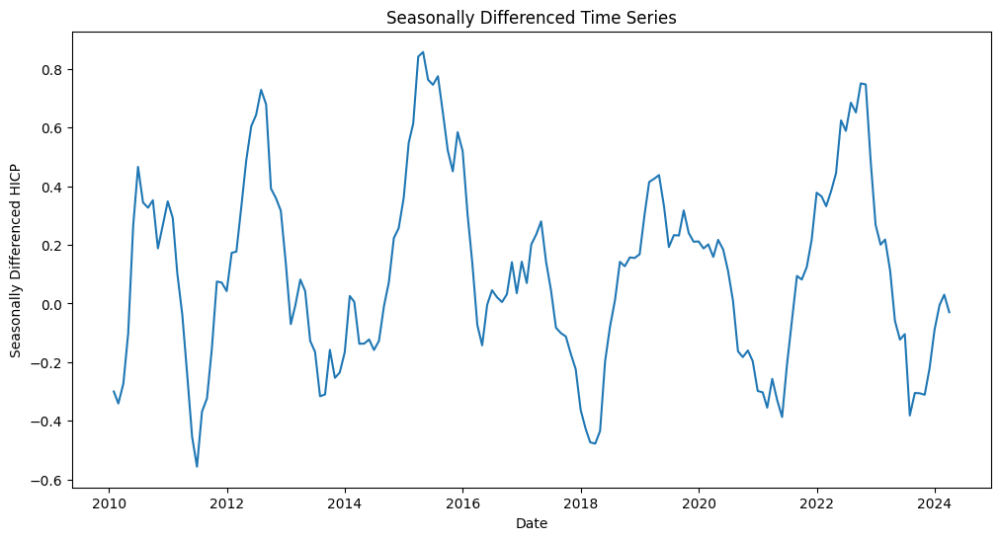

p-value: 0.01603930799795592
Ljung-Box test:
       lb_stat     lb_pvalue
10  459.182784  2.295809e-92
Box-Pierce test:
Q-statistic: 635.9453589066951, p-value: 2.846345599590083e-129
Phillips-Perron test:
     Phillips-Perron Test (Z-tau)    
Test Statistic                 -3.207
P-value                         0.020
Lags                               14
-------------------------------------

Trend: Constant
Critical Values: -3.47 (1%), -2.88 (5%), -2.58 (10%)
Null Hypothesis: The process contains a unit root.
Alternative Hypothesis: The process is weakly stationary.
(0.0369617241696847, 0.1, 8, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})


<ipython-input-14-3e017b6180c6>:46: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  print(sm.tsa.stattools.kpss(seasonal_diff, regression='ct'))


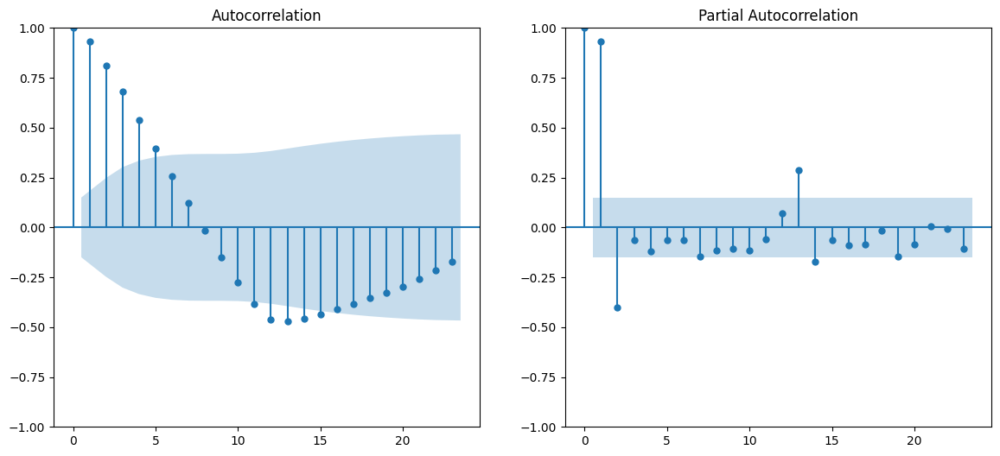

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose
result = seasonal_decompose((rata_schimb), model='additive', period=12)

seasonal = result.seasonal
plt.figure(figsize=(12, 6))
plt.plot(seasonal)
plt.title('Seasonal Component')
plt.xlabel('Date')
plt.ylabel('Seasonal')
plt.show()

seasonal_diff = rata_schimb.diff(12).dropna()
plt.figure(figsize=(12, 6))
plt.plot(seasonal_diff)
plt.title('Seasonally Differenced Time Series')
plt.xlabel('Date')
plt.ylabel('Seasonally Differenced HICP')
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(14, 6))

plot_acf(seasonal_diff, ax=axes[0])

plot_pacf(seasonal_diff, ax=axes[1])

adf_test = adfuller(seasonal_diff)

print(f'p-value: {adf_test[1]}')

# Ljung-Box test
ljung_box_test = acorr_ljungbox(seasonal_diff, lags=[10], return_df=True)
print('Ljung-Box test:')
print(ljung_box_test)

# Box-Pierce test
box_pierce_test = q_stat(acf(seasonal_diff, nlags=10), len(seasonal_diff))
print('Box-Pierce test:')
print(f'Q-statistic: {box_pierce_test[0][-1]}, p-value: {box_pierce_test[1][-1]}')

# Phillips-Perron test
pp_test = PhillipsPerron(seasonal_diff)
print('Phillips-Perron test:')
print(pp_test)
#kpss = KPSS()
#print(kpss.summary().as_text())
print(sm.tsa.stattools.kpss(seasonal_diff, regression='ct'))

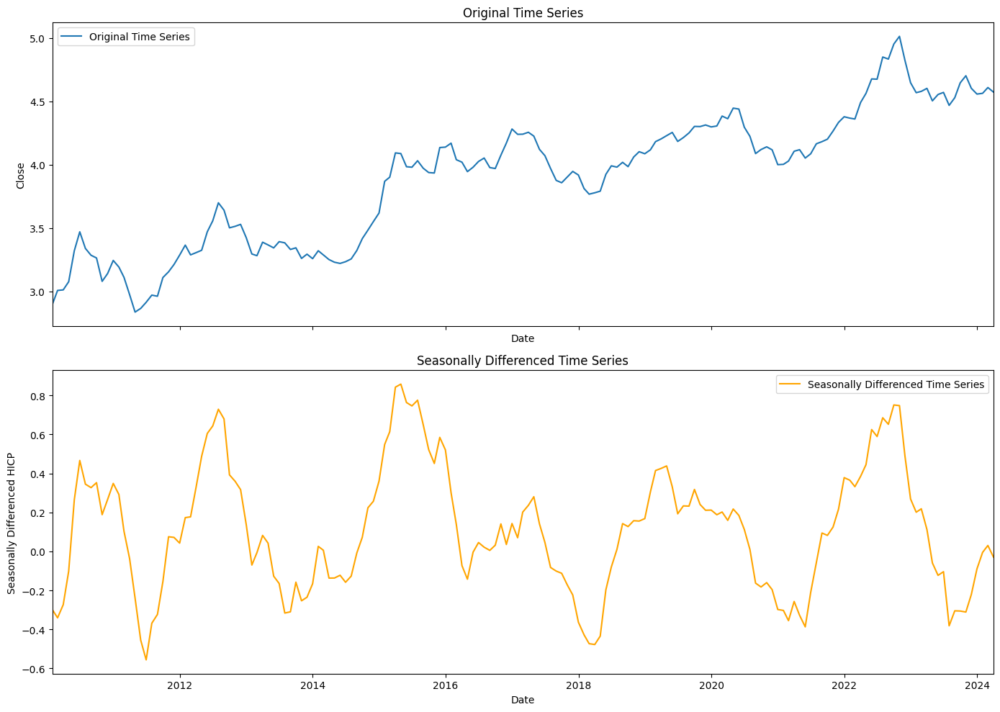

In [ ]:
fig, axes = plt.subplots(2, 1, figsize=(14, 10), sharex=True)

# Plot the original time series, adjusting to the date range of the seasonally adjusted series
axes[0].plot(rata_schimb, label='Original Time Series')
axes[0].set_xlim(seasonal_diff.index.min(), seasonal_diff.index.max())
axes[0].set_title('Original Time Series')
axes[0].set_xlabel('Date')
axes[0].set_ylabel('Close')
axes[0].legend()

# Plot the seasonally differenced time series
axes[1].plot(seasonal_diff, label='Seasonally Differenced Time Series', color='orange')
axes[1].set_title('Seasonally Differenced Time Series')
axes[1].set_xlabel('Date')
axes[1].set_ylabel('Seasonally Differenced HICP')
axes[1].legend()
# Adjust layout
plt.tight_layout()
plt.show()

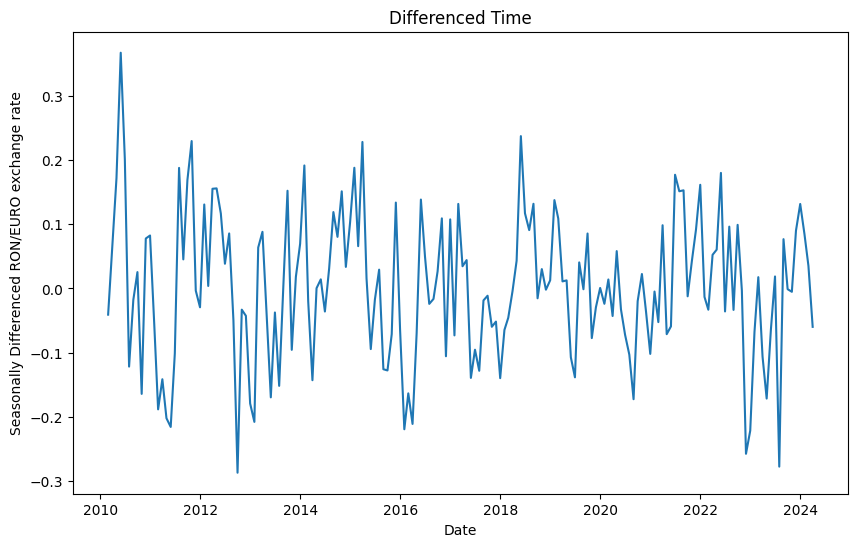

p-value: 1.5862357600136689e-06
Ljung-Box test:
      lb_stat  lb_pvalue
10  33.677334   0.000209
Box-Pierce test:
Q-statistic: 206.8969157377554, p-value: 2.750593589601482e-38
Phillips-Perron test:
     Phillips-Perron Test (Z-tau)    
Test Statistic                 -8.291
P-value                         0.000
Lags                               14
-------------------------------------

Trend: Constant
Critical Values: -3.47 (1%), -2.88 (5%), -2.58 (10%)
Null Hypothesis: The process contains a unit root.
Alternative Hypothesis: The process is weakly stationary.
(0.02782139978135106, 0.1, 5, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})


<ipython-input-16-06c4a5ad3e67>:35: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  print(sm.tsa.stattools.kpss(diff_df, regression='ct'))


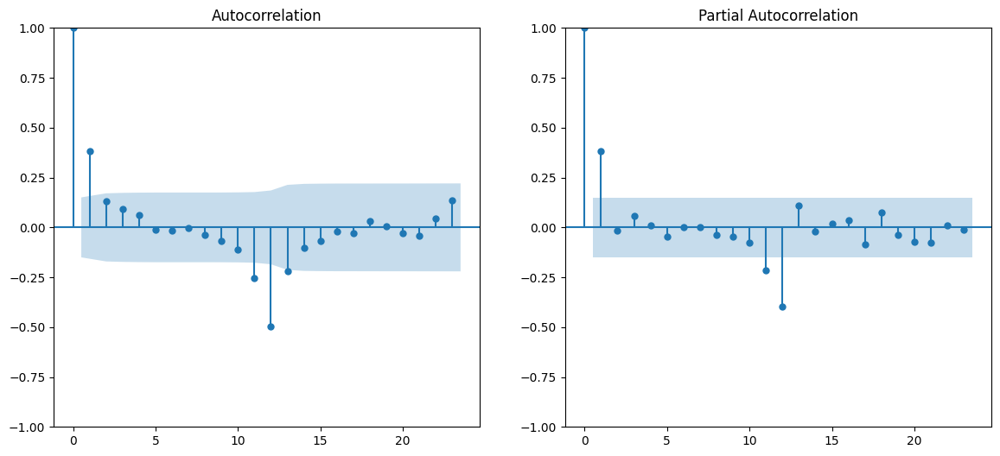

In [ ]:
diff_df = seasonal_diff.diff().dropna()

plt.figure(figsize=(10, 6))
plt.plot(diff_df)
plt.title('Differenced Time')
plt.xlabel('Date')
plt.ylabel('Seasonally Differenced RON/EURO exchange rate')
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(14, 6))

plot_acf(diff_df, ax=axes[0])

plot_pacf(diff_df, ax=axes[1])

adf_test = adfuller(diff_df)

print(f'p-value: {adf_test[1]}')
# Ljung-Box test
ljung_box_test = acorr_ljungbox(diff_df, lags=[10], return_df=True)
print('Ljung-Box test:')
print(ljung_box_test)

# Box-Pierce test
box_pierce_test = q_stat(acf(diff_df, nlags=10), len(diff_df))
print('Box-Pierce test:')
print(f'Q-statistic: {box_pierce_test[0][-1]}, p-value: {box_pierce_test[1][-1]}')

# Phillips-Perron test
pp_test = PhillipsPerron(diff_df)
print('Phillips-Perron test:')
print(pp_test)
#kpss = KPSS()
#print(kpss.summary().as_text())
print(sm.tsa.stattools.kpss(diff_df, regression='ct'))

#Seria Somaj e integrabila de ordin 1

Seasonally Adjusted Inflatie:
 T
2009-01-31    6.837526
2009-02-28    6.919372
2009-03-31    6.738122
2009-04-30    6.419967
2009-05-31    5.910146
                ...   
2023-11-30    6.836931
2023-12-31    6.986931
2024-01-31    7.337526
2024-02-29    7.119372
2024-03-31    6.738122
Freq: M, Length: 183, dtype: float64
Seasonally Adjusted Somaj:
 T
2009-01-31    7.924940
2009-02-28    8.199643
2009-03-31    8.124048
2009-04-30    8.098155
2009-05-31    8.229107
                ...   
2023-11-30    5.492500
2023-12-31    5.584167
2024-01-31    5.724940
2024-02-29    5.599643
2024-03-31    5.324048
Freq: M, Length: 183, dtype: float64


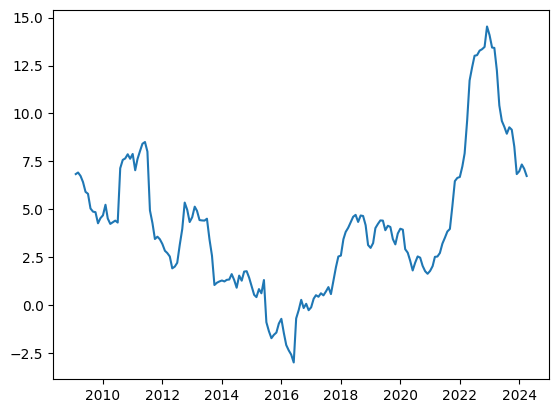

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

# Decompose the time series
inflatie_decompose = seasonal_decompose(inflatie['HICP'], model='additive', period=12)
somaj_decompose = seasonal_decompose(somaj['Rata Somajului'], model='additive', period=12)
rata_decompose = seasonal_decompose(rata_schimb['RON/USD'], model='additive', period=12)

# Retrieve the seasonally adjusted series
inflatie_adjusted = inflatie['HICP'] - inflatie_decompose.seasonal
somaj_adjusted = somaj['Rata Somajului'] - somaj_decompose.seasonal
rata_adjusted = rata_schimb['RON/USD'] - somaj_decompose.seasonal
# Print seasonally adjusted series
print("Seasonally Adjusted Inflatie:\n", inflatie_adjusted)
print("Seasonally Adjusted Somaj:\n", somaj_adjusted)

plt.plot(inflatie_adjusted)

Combined DataFrame:
                somaj  inflatie  rata_schimb
2009-01-31  7.924940  6.837526     3.224840
2009-02-28  8.199643  6.919372     3.347643
2009-03-31  8.124048  6.738122     3.309148
2009-04-30  8.098155  6.419967     3.175855
2009-05-31  8.229107  5.910146     3.084507
...              ...       ...          ...
2023-11-30  5.492500  6.836931     4.596000
2023-12-31  5.584167  6.986931     4.542167
2024-01-31  5.724940  7.337526     4.588940
2024-02-29  5.599643  7.119372     4.609343
2024-03-31  5.324048  6.738122     4.597548

[183 rows x 3 columns]


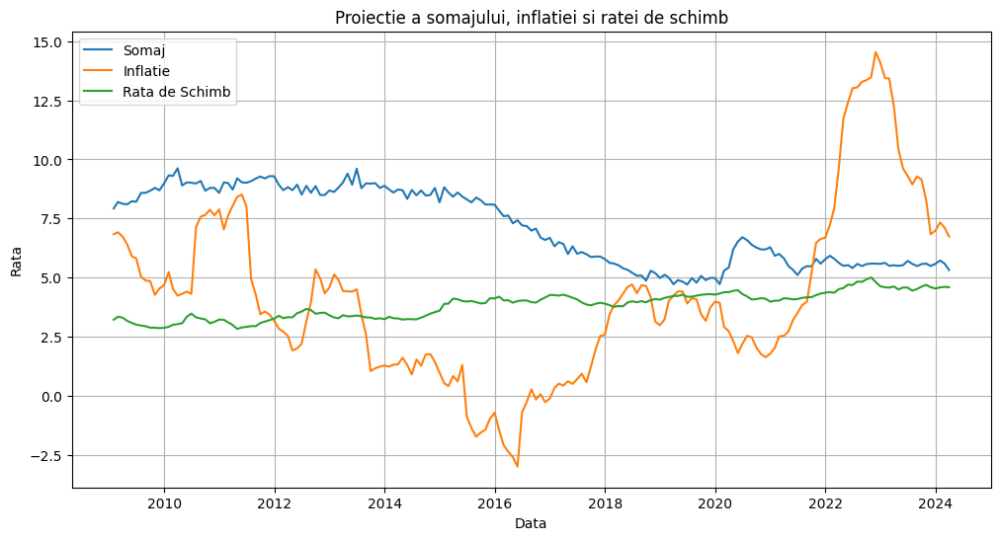

In [ ]:
df = pd.DataFrame({
    'somaj': somaj_adjusted,
    'inflatie': inflatie_adjusted,
    'rata_schimb': rata_adjusted
})

# Print the combined DataFrame
print("Combined DataFrame:\n", df)

# Plot the seasonally adjusted series
plt.figure(figsize=(12, 6))
plt.plot(df.index, df['somaj'], label='Somaj')
plt.plot(df.index, df['inflatie'], label='Inflatie')
plt.plot(df.index, df['rata_schimb'], label='Rata de Schimb')
plt.title('Proiectie a somajului, inflatiei si ratei de schimb')
plt.xlabel('Data')
plt.ylabel('Rata')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
total_samples = len(df)
print(total_samples)
# Calculate the number of samples for the training set (80%)
train_samples = int(total_samples * 0.8)

# Calculate the number of samples for the test set (20%)
nobs = total_samples - train_samples

# Split the DataFrame
df_train, df_test = df[:train_samples], df[train_samples:]

# Check the size of the resulting splits
print(f"Training set shape: {df_train.shape}")  # should be approximately 80% of total samples
print(f"Test set shape: {df_test.shape}")
df_train.head(5)
df_test.head(5)

183
Training set shape: (146, 3)
Test set shape: (37, 3)


,somaj,inflatie,rata_schimb
2021-03-31,5.824048,2.538122,4.130448
2021-04-30,5.498155,2.719967,4.116955
2021-05-31,5.329107,3.210146,4.081707
2021-06-30,5.109464,3.509550,4.095864
2021-07-31,5.381885,3.841951,4.147085


In [ ]:
from statsmodels.tsa.api import VAR
def select_optimal_lags(data, maxlags=12):
    model = VAR(df)
    lag_order = model.select_order(maxlags=maxlags)
    return lag_order

# Get the optimal lags
optimal_lags = select_optimal_lags(df, maxlags=12)

# Print the selection criteria
print(optimal_lags)
print(optimal_lags.selected_orders)
#Putem alege atat 8 cat si 2

<statsmodels.tsa.vector_ar.var_model.LagOrderResults object. Selected orders are: AIC -> 2, BIC -> 2, FPE -> 2, HQIC ->  2>
{'aic': 2, 'bic': 2, 'hqic': 2, 'fpe': 2}


In [ ]:
from statsmodels.tsa.vector_ar.vecm import coint_johansen
jres = coint_johansen(df, det_order=0, k_ar_diff=8)
print("Eigenvalues:", jres.eig)
print("Eigenvectors:\n", jres.evec)
print("Trace statistic:", jres.lr1)
print("Critical values (Trace statistic):\n", jres.cvt)
print("Maximum eigenvalue statistic:", jres.lr2)
print("Critical values (Maximum eigenvalue statistic):\n", jres.cvm)
print("Number of cointegrating relations:", jres.ind)

print('\n')

from statsmodels.tsa.vector_ar.vecm import coint_johansen
jres = coint_johansen(df, det_order=0, k_ar_diff=2)
print("Eigenvalues:", jres.eig)
print("Eigenvectors:\n", jres.evec)
print("Trace statistic:", jres.lr1)
print("Critical values (Trace statistic):\n", jres.cvt)
print("Maximum eigenvalue statistic:", jres.lr2)
print("Critical values (Maximum eigenvalue statistic):\n", jres.cvm)
print("Number of cointegrating relations:", jres.ind)


Eigenvalues: [0.0613632  0.03904391 0.00508368]
Eigenvectors:
 [[ 1.12150876 -0.49609877  0.55555127]
 [-0.11912382 -0.30710104  0.00693664]
 [ 3.87622107 -1.14303129 -0.3791928 ]]
Trace statistic: [18.83547964  7.81663902  0.88681649]
Critical values (Trace statistic):
 [[27.0669 29.7961 35.4628]
 [13.4294 15.4943 19.9349]
 [ 2.7055  3.8415  6.6349]]
Maximum eigenvalue statistic: [11.01884062  6.92982253  0.88681649]
Critical values (Maximum eigenvalue statistic):
 [[18.8928 21.1314 25.865 ]
 [12.2971 14.2639 18.52  ]
 [ 2.7055  3.8415  6.6349]]
Number of cointegrating relations: [0 1 2]


Eigenvalues: [0.06714581 0.03627122 0.00563587]
Eigenvectors:
 [[ 0.65031942 -0.93780948  0.30768927]
 [-0.21355401 -0.19631785 -0.0443006 ]
 [ 2.49650266 -2.18072889 -0.95512889]]
Trace statistic: [20.17864154  7.66749388  1.01732664]
Critical values (Trace statistic):
 [[27.0669 29.7961 35.4628]
 [13.4294 15.4943 19.9349]
 [ 2.7055  3.8415  6.6349]]
Maximum eigenvalue statistic: [12.51114766  6.65

In [ ]:
from statsmodels.tsa.stattools import adfuller
df_diff = df_train.diff().dropna()
#adfuller_test(df_diff)
model = VAR(df_diff)
fitted_model = model.fit(2)  # 8 lags

# Print the summary
#summary = model.summary()
#print(summary)
fitted_model.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 28, Jun, 2024
Time:                     17:32:12
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                   -8.34538
Nobs:                     143.000    HQIC:                  -8.60368
Log likelihood:           40.0801    FPE:                0.000153740
AIC:                     -8.78049    Det(Omega_mle):     0.000133205
--------------------------------------------------------------------
Results for equation somaj
                    coefficient       std. error           t-stat            prob
---------------------------------------------------------------------------------
const                 -0.022622         0.019667           -1.150           0.250
L1.somaj              -0.389041         0.084933           -4.581           0.000
L1.inflatie           -0.035224         0.032326        

In [ ]:
from statsmodels.tsa.stattools import grangercausalitytests
print("Testing Granger causality: somaj -> inflatie")
granger_test_result = grangercausalitytests(df[['inflatie', 'somaj']], maxlag=2, verbose=True)
print("\n")

print("Testing Granger causality: inflatie -> somaj")
granger_test_result = grangercausalitytests(df[['somaj', 'inflatie']], maxlag=2, verbose=True)
print("\n")

print("Testing Granger causality: somaj -> rata_schimb")
granger_test_result = grangercausalitytests(df[['rata_schimb', 'somaj']], maxlag=2, verbose=True)
print("\n")

print("Testing Granger causality: rata_schimb -> somaj")
granger_test_result = grangercausalitytests(df[['somaj', 'rata_schimb']], maxlag=2, verbose=True)
print("\n")

print("Testing Granger causality: inflatie -> rata_schimb")
granger_test_result = grangercausalitytests(df[['rata_schimb', 'inflatie']], maxlag=2, verbose=True)
print("\n")

print("Testing Granger causality: rata_schimb -> inflatie")
granger_test_result = grangercausalitytests(df[['inflatie', 'rata_schimb']], maxlag=2, verbose=True)
print("\n")

Testing Granger causality: somaj -> inflatie

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=3.3405  , p=0.0693  , df_denom=179, df_num=1
ssr based chi2 test:   chi2=3.3965  , p=0.0653  , df=1
likelihood ratio test: chi2=3.3652  , p=0.0666  , df=1
parameter F test:         F=3.3405  , p=0.0693  , df_denom=179, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=1.1935  , p=0.3056  , df_denom=176, df_num=2
ssr based chi2 test:   chi2=2.4547  , p=0.2931  , df=2
likelihood ratio test: chi2=2.4382  , p=0.2955  , df=2
parameter F test:         F=1.1935  , p=0.3056  , df_denom=176, df_num=2


Testing Granger causality: inflatie -> somaj

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=1.4824  , p=0.2250  , df_denom=179, df_num=1
ssr based chi2 test:   chi2=1.5073  , p=0.2196  , df=1
likelihood ratio test: chi2=1.5011  , p=0.2205  , df=1
parameter F test:         F=1.4824  , p=0.2250  , df_denom=179, df_num=1

G

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(



likelihood ratio test: chi2=6.0914  , p=0.0476  , df=2
parameter F test:         F=3.0119  , p=0.0517  , df_denom=176, df_num=2


Testing Granger causality: somaj -> rata_schimb

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=1.8161  , p=0.1795  , df_denom=179, df_num=1
ssr based chi2 test:   chi2=1.8466  , p=0.1742  , df=1
likelihood ratio test: chi2=1.8373  , p=0.1753  , df=1
parameter F test:         F=1.8161  , p=0.1795  , df_denom=179, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=2.4436  , p=0.0898  , df_denom=176, df_num=2
ssr based chi2 test:   chi2=5.0261  , p=0.0810  , df=2
likelihood ratio test: chi2=4.9575  , p=0.0838  , df=2
parameter F test:         F=2.4436  , p=0.0898  , df_denom=176, df_num=2


Testing Granger causality: rata_schimb -> somaj

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=5.5600  , p=0.0195  , df_denom=179, df_num=1
ssr based chi2 test:   chi2=5.6532  , p=0.0174  

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(


ssr based F test:         F=0.2115  , p=0.6462  , df_denom=179, df_num=1
ssr based chi2 test:   chi2=0.2150  , p=0.6429  , df=1
likelihood ratio test: chi2=0.2149  , p=0.6430  , df=1
parameter F test:         F=0.2115  , p=0.6462  , df_denom=179, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.6542  , p=0.5211  , df_denom=176, df_num=2
ssr based chi2 test:   chi2=1.3455  , p=0.5103  , df=2
likelihood ratio test: chi2=1.3405  , p=0.5116  , df=2
parameter F test:         F=0.6542  , p=0.5211  , df_denom=176, df_num=2


Testing Granger causality: rata_schimb -> inflatie

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=2.8713  , p=0.0919  , df_denom=179, df_num=1
ssr based chi2 test:   chi2=2.9194  , p=0.0875  , df=1
likelihood ratio test: chi2=2.8962  , p=0.0888  , df=1
parameter F test:         F=2.8713  , p=0.0919  , df_denom=179, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=1.6436  , p=0

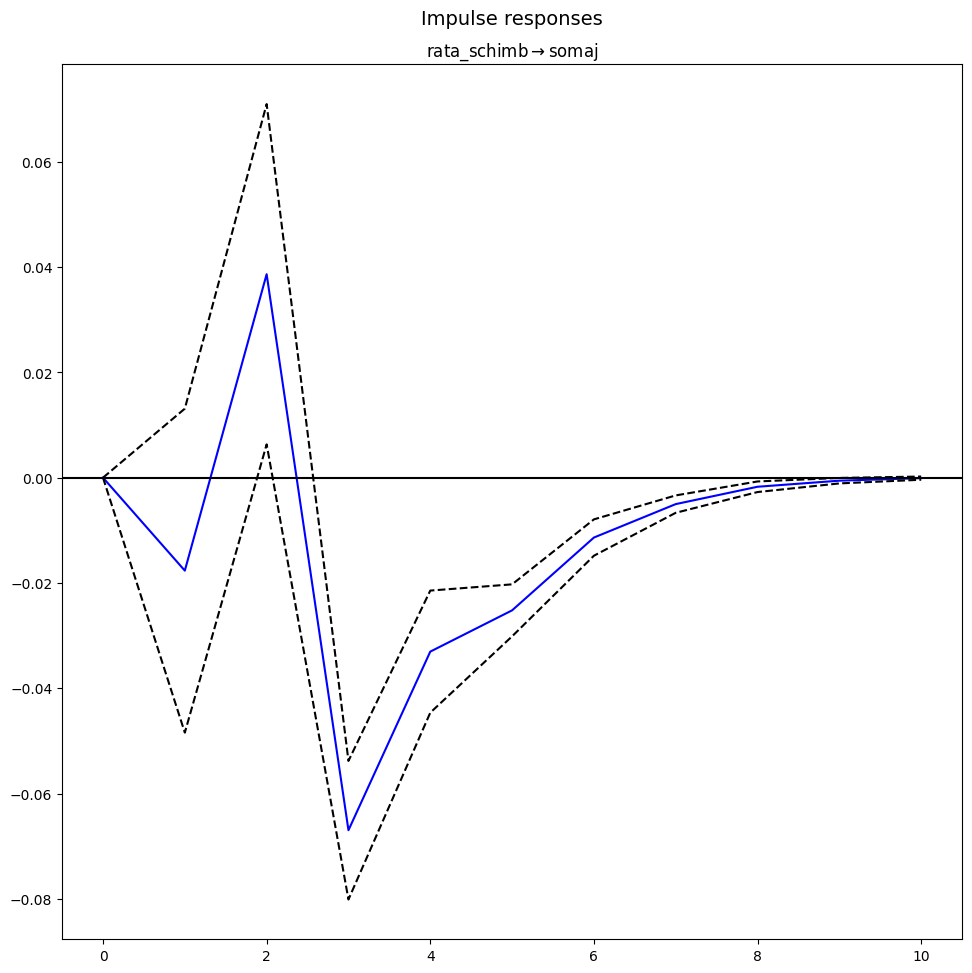

<Figure size 1000x600 with 0 Axes>

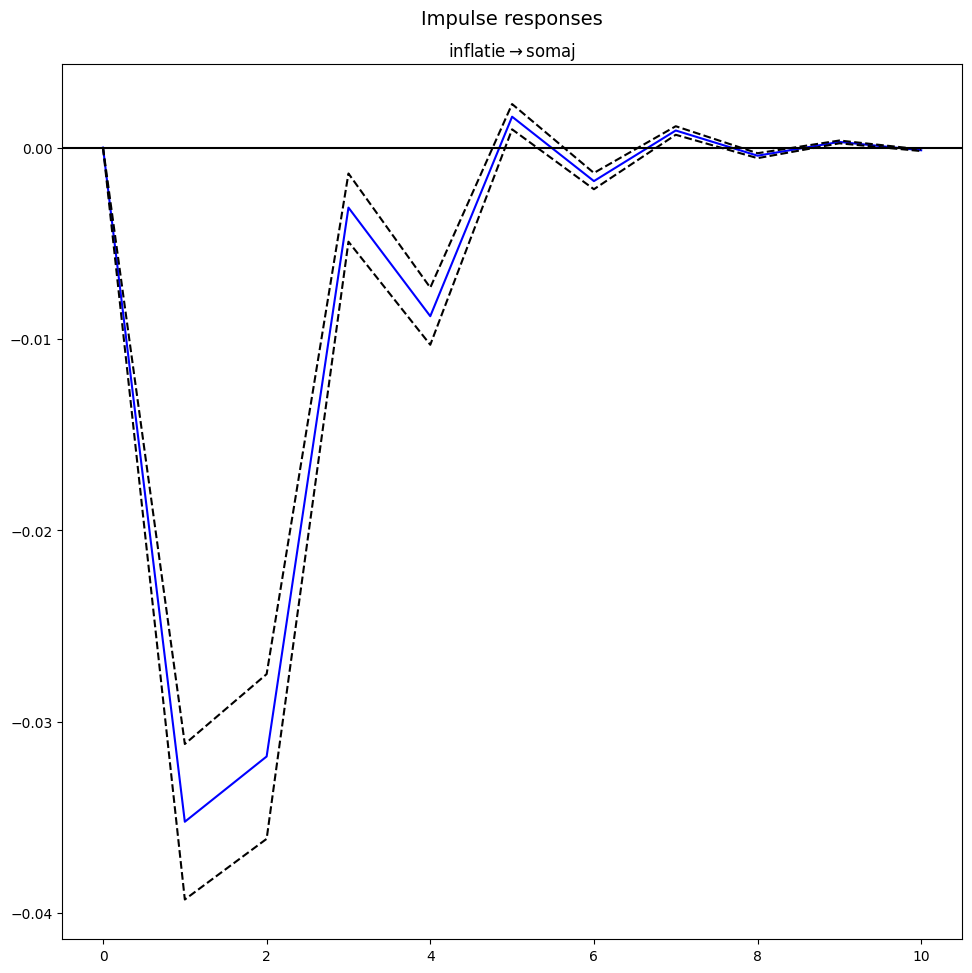

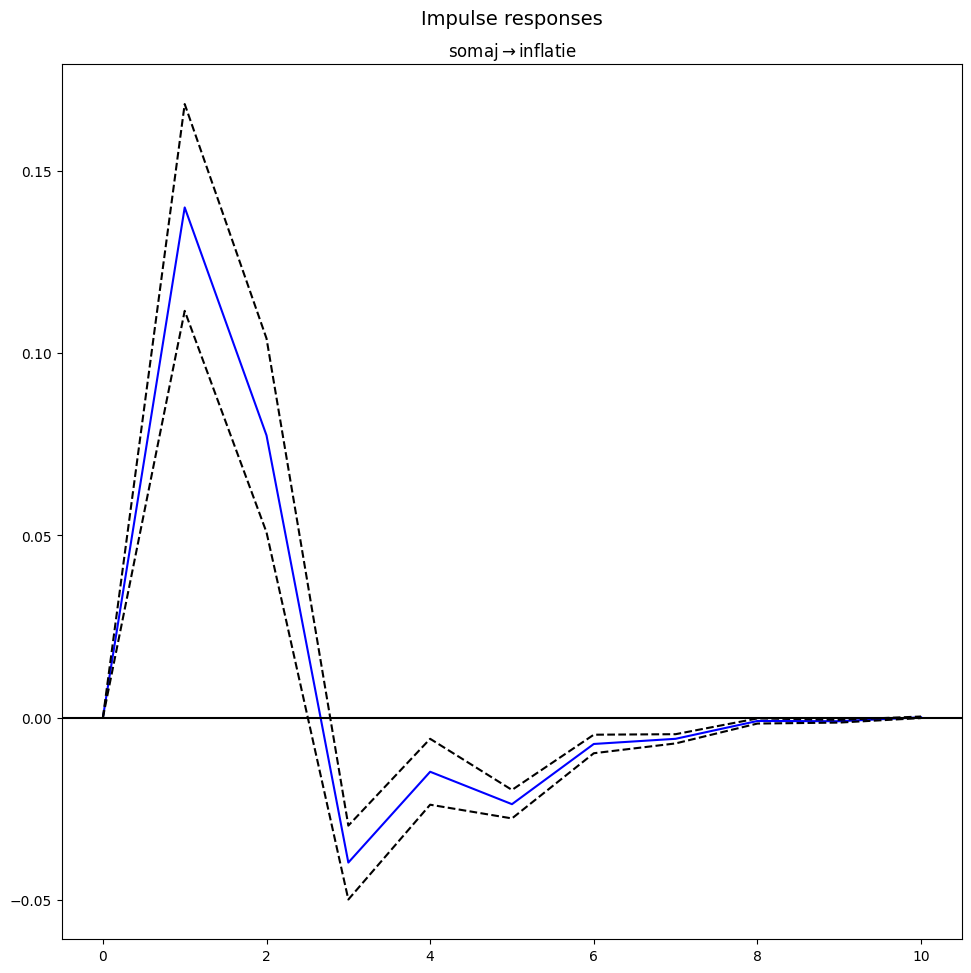

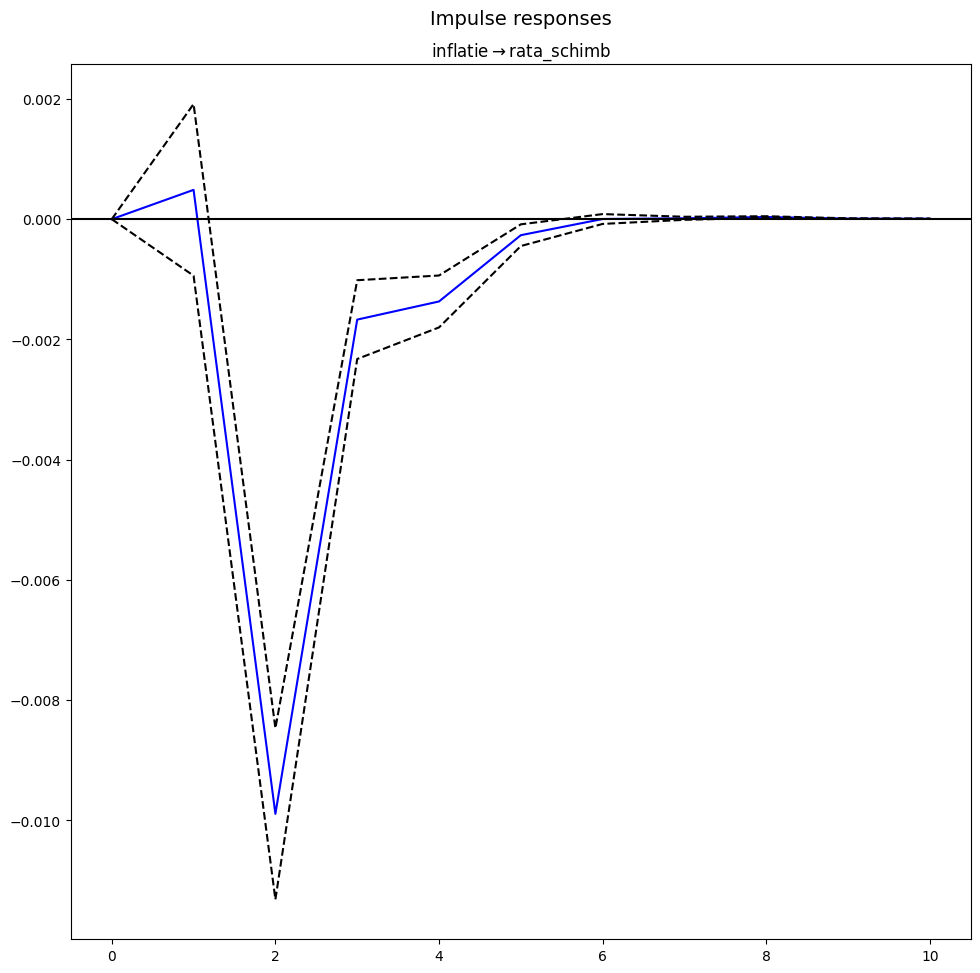

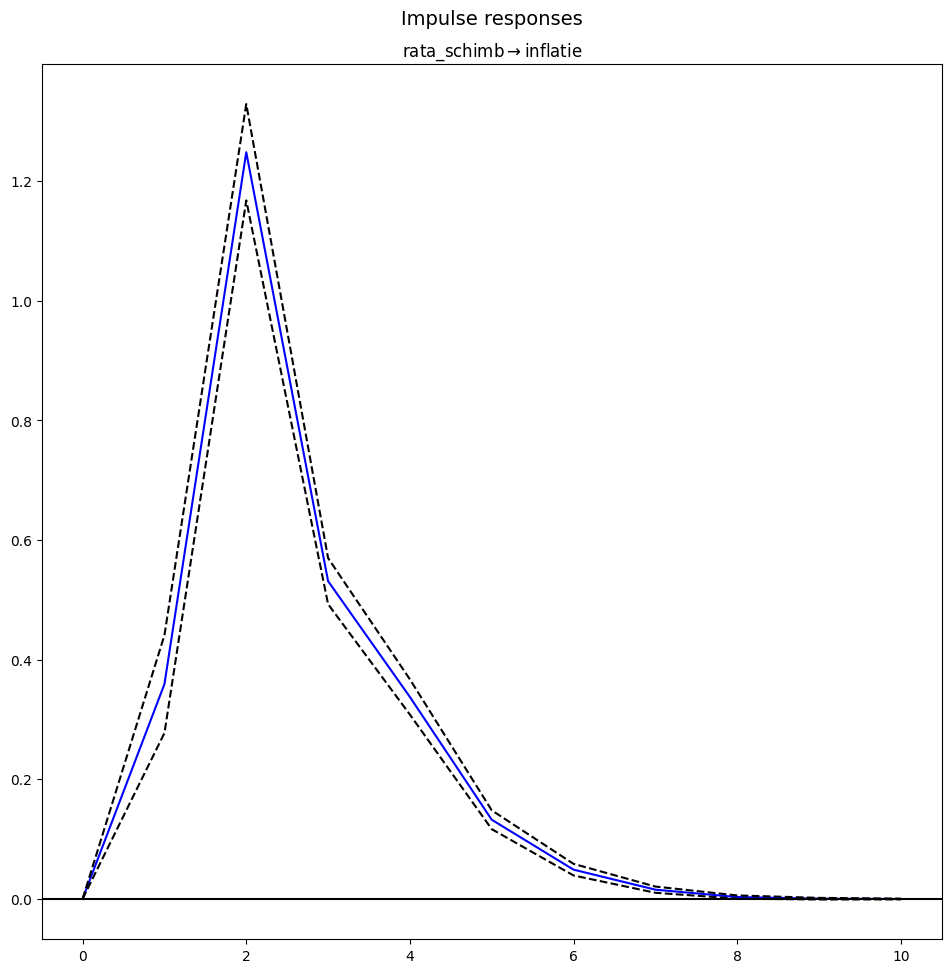

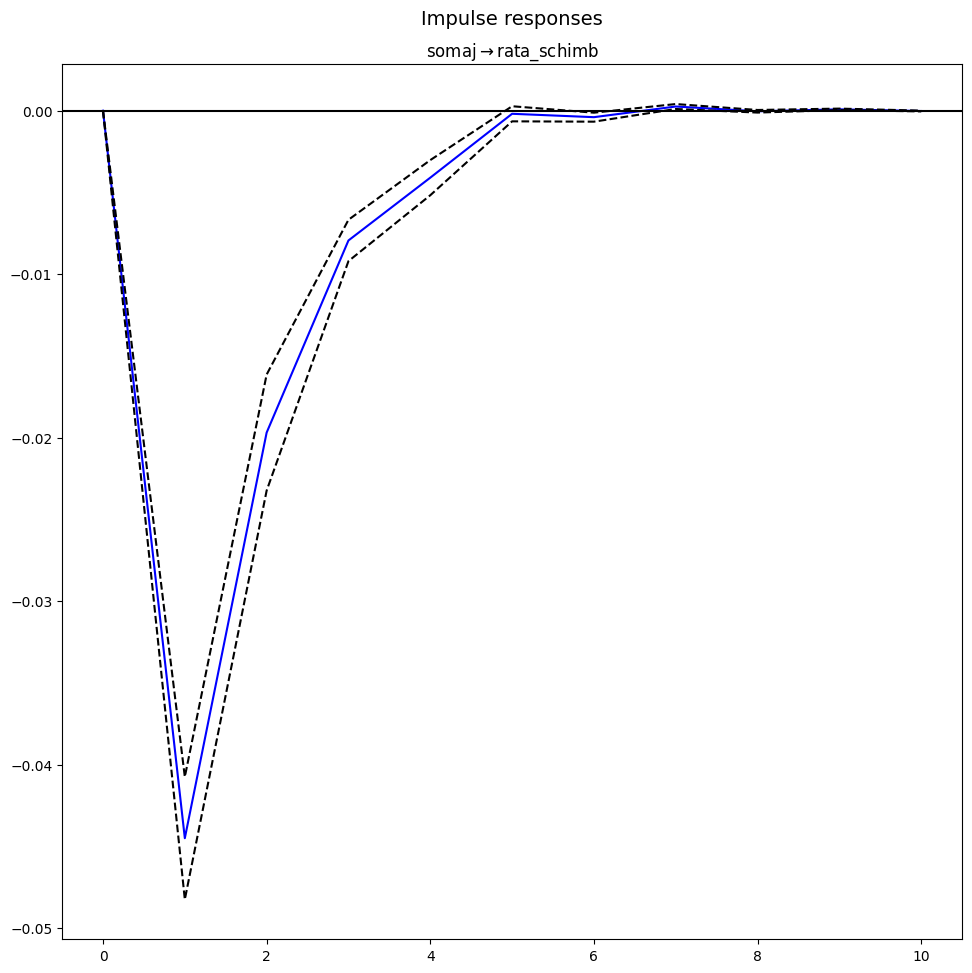

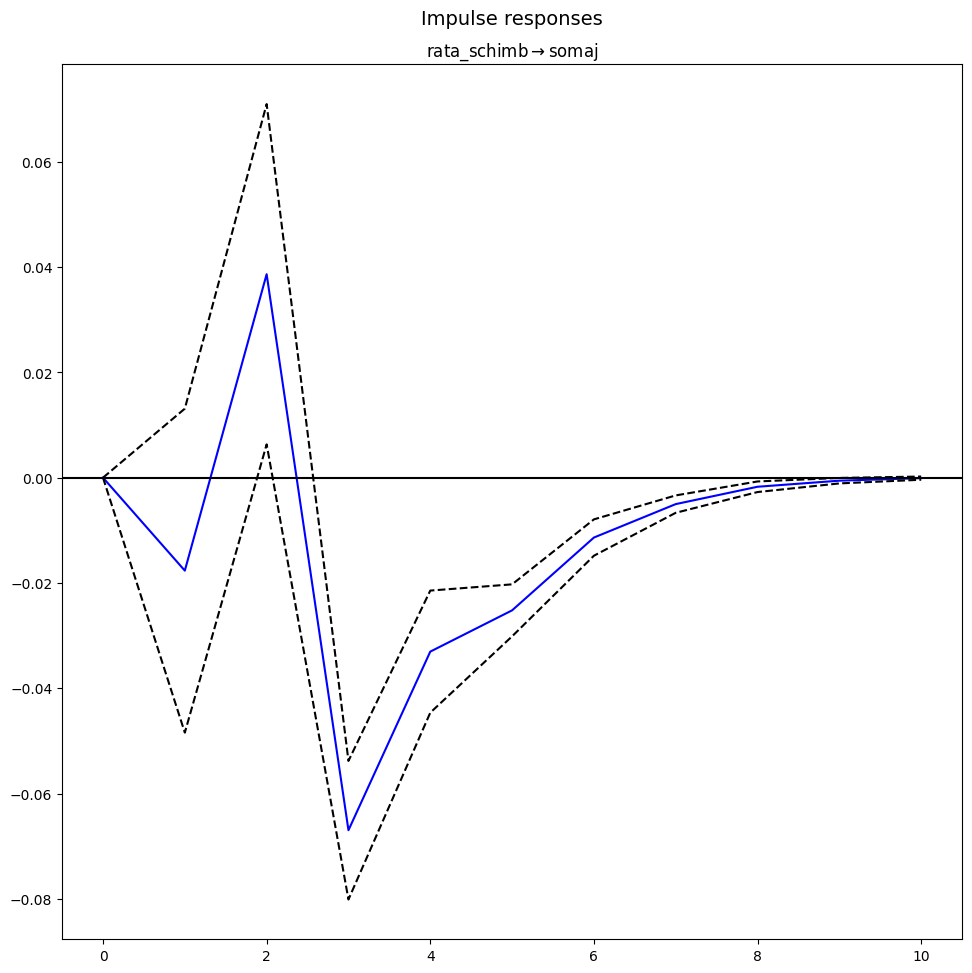

In [ ]:
irf = fitted_model.irf()
plt.figure(figsize=(10, 6))
irf.plot(impulse='inflatie', response='somaj', plot_stderr=True, stderr_type='asym', repl=1000, signif=0.9)
irf.plot(impulse='somaj', response='inflatie', plot_stderr=True, stderr_type='asym', repl=1000, signif=0.9)
irf.plot(impulse='inflatie', response='rata_schimb', plot_stderr=True, stderr_type='asym', repl=1000, signif=0.9)
irf.plot(impulse='rata_schimb', response='inflatie', plot_stderr=True, stderr_type='asym', repl=1000, signif=0.9)
irf.plot(impulse='somaj', response='rata_schimb', plot_stderr=True, stderr_type='asym', repl=1000, signif=0.9)
irf.plot(impulse='rata_schimb', response='somaj', plot_stderr=True, stderr_type='asym', repl=1000, signif=0.9)

FEVD for somaj
         somaj  inflatie  rata_schimb
0     1.000000  0.000000     0.000000
1     0.992585  0.007382     0.000032
2     0.986786  0.013037     0.000177
3     0.986571  0.012824     0.000604
4     0.986177  0.013117     0.000705
5     0.986114  0.013121     0.000765
6     0.986097  0.013126     0.000777
7     0.986092  0.013130     0.000779
8     0.986091  0.013130     0.000779
9     0.986091  0.013130     0.000779
10    0.986091  0.013130     0.000779
11    0.986091  0.013130     0.000779

FEVD for inflatie
         somaj  inflatie  rata_schimb
0     0.006180  0.993820     0.000000
1     0.007444  0.990443     0.002112
2     0.007731  0.965609     0.026659
3     0.007904  0.961137     0.030959
4     0.007907  0.959403     0.032690
5     0.007968  0.959079     0.032953
6     0.007973  0.959038     0.032989
7     0.007976  0.959031     0.032993
8     0.007976  0.959031     0.032993
9     0.007977  0.959031     0.032993
10    0.007977  0.959031     0.032993
11    0.007977  

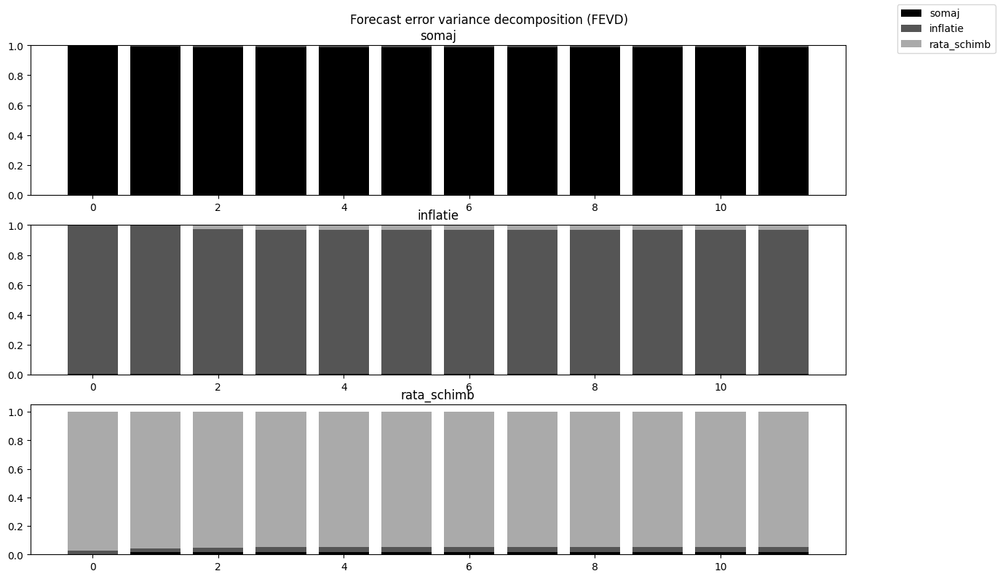

In [ ]:
fevd = fitted_model.fevd(12)  # n.ahead=12 periods

# Display FEVD results
print(fevd.summary())

# Plot FEVD results
fevd.plot(figsize=(14, 8))
plt.show()

In [ ]:
lag_order = fitted_model.k_ar
print(lag_order)  #> 4

# Input data for forecasting
forecast_input = df_diff.values[-lag_order:]
forecast_input

fc = fitted_model.forecast(y=forecast_input, steps=nobs)
df_forecast = pd.DataFrame(fc, index=df.index[-nobs:], columns=df.columns + '_2d')
df_forecast

2


,somaj_2d,inflatie_2d,rata_schimb_2d
2021-03-31,-0.112757,0.109663,0.009040
2021-04-30,0.006159,0.043954,0.001536
2021-05-31,-0.041850,-0.005977,0.004837
2021-06-30,-0.007221,-0.021708,0.004586
2021-07-31,-0.022912,-0.027187,0.005109
2021-08-31,-0.012513,-0.027933,0.005096
2021-09-30,-0.017886,-0.028500,0.005168
2021-10-31,-0.014694,-0.028167,0.005134
2021-11-30,-0.016467,-0.028297,0.005148
2021-12-31,-0.015463,-0.028182,0.005133


In [ ]:
def invert_transformation(df_train, df_forecast, second_diff=False):
    """Revert back the differencing to get the forecast to original scale."""
    df_fc = df_forecast.copy()
    columns = df_train.columns
    for col in columns:
        # Roll back 2nd Diff
        if second_diff:
            df_fc[str(col)+'_1d'] = (df_train[col].iloc[-1]-df_train[col].iloc[-2]) + df_fc[str(col)+'_2d'].cumsum()
        # Roll back 1st Diff
        df_fc[str(col)+'_forecast'] = df_train[col].iloc[-1] + df_fc[str(col)+'_1d'].cumsum()
    return df_fc

In [ ]:
df_results = invert_transformation(df_train, df_forecast, second_diff=True)
df_results

,somaj_2d,inflatie_2d,rata_schimb_2d,somaj_1d,somaj_forecast,inflatie_1d,inflatie_forecast,rata_schimb_1d,rata_schimb_forecast
2021-03-31,-0.112757,0.109663,0.009040,-0.038055,5.961588,0.591509,3.110880,0.009742,4.038285
2021-04-30,0.006159,0.043954,0.001536,-0.031896,5.929692,0.635463,3.746343,0.011278,4.049563
2021-05-31,-0.041850,-0.005977,0.004837,-0.073746,5.855946,0.629486,4.375829,0.016115,4.065678
2021-06-30,-0.007221,-0.021708,0.004586,-0.080967,5.774979,0.607778,4.983607,0.020701,4.086379
2021-07-31,-0.022912,-0.027187,0.005109,-0.103879,5.671100,0.580591,5.564199,0.025810,4.112189
2021-08-31,-0.012513,-0.027933,0.005096,-0.116392,5.554708,0.552658,6.116857,0.030907,4.143096
2021-09-30,-0.017886,-0.028500,0.005168,-0.134278,5.420430,0.524158,6.641015,0.036074,4.179170
2021-10-31,-0.014694,-0.028167,0.005134,-0.148972,5.271458,0.495992,7.137007,0.041208,4.220378
2021-11-30,-0.016467,-0.028297,0.005148,-0.165439,5.106019,0.467695,7.604702,0.046356,4.266734
2021-12-31,-0.015463,-0.028182,0.005133,-0.180902,4.925117,0.439513,8.044215,0.051489,4.318223


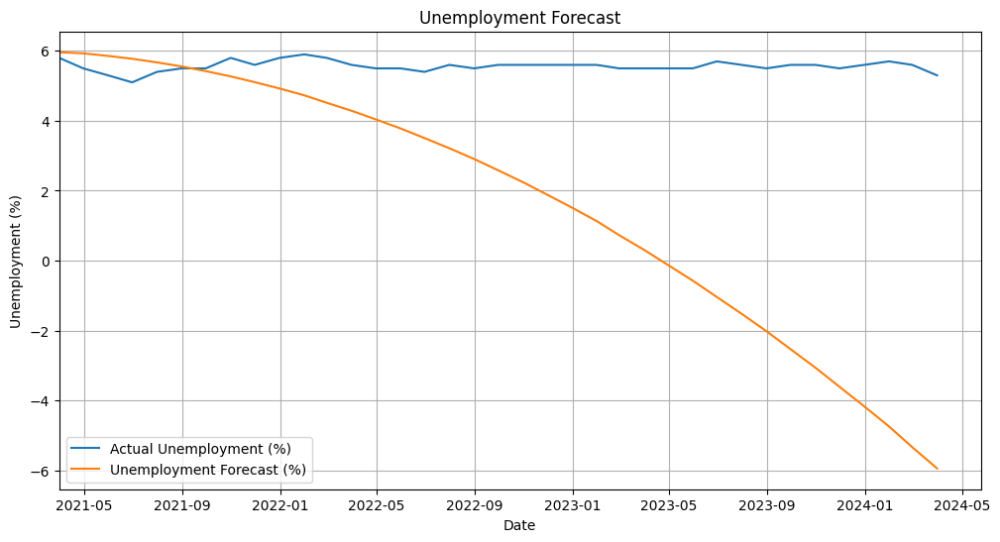

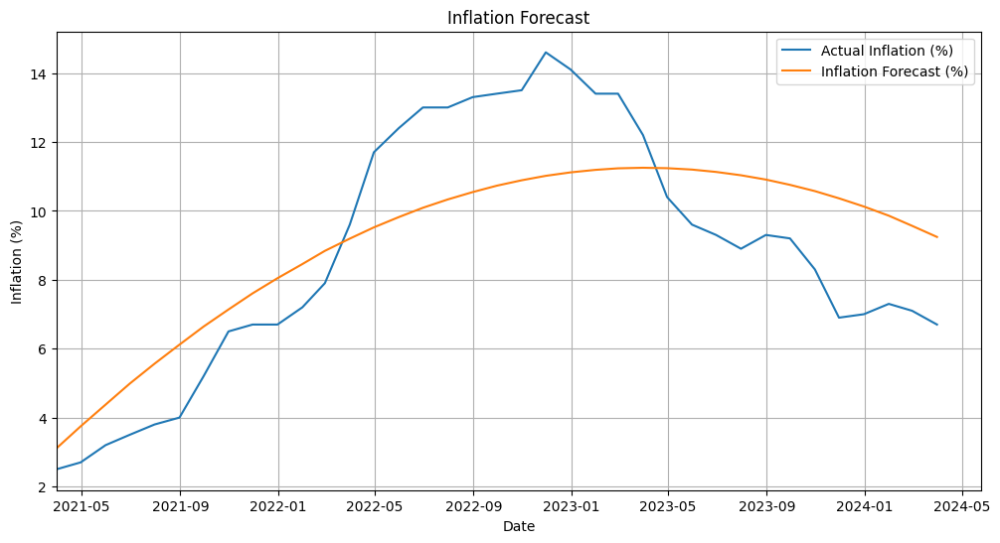

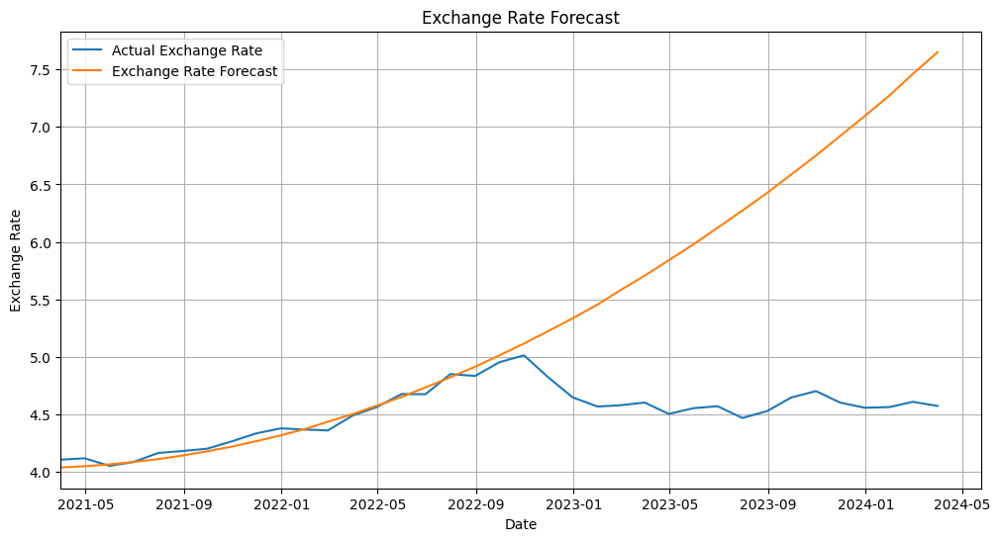

In [ ]:
aligned_somaj = somaj[df_results.index.min():]
aligned_inflatie = inflatie[df_results.index.min():]
aligned_rata_schimb = rata_schimb[df_results.index.min():]

# Unemployment Forecast plot
plt.figure(figsize=(12, 6))
plt.plot(aligned_somaj, label='Actual Unemployment (%)')
plt.plot(df_results['somaj_forecast'], label='Unemployment Forecast (%)')
plt.title('Unemployment Forecast')
plt.xlabel('Date')
plt.ylabel('Unemployment (%)')
plt.legend()
plt.grid(True)
plt.xlim(left=df_results.index.min())  # Ensuring the x-axis starts at the forecast index
plt.show()

# Inflation Forecast plot
plt.figure(figsize=(12, 6))
plt.plot(aligned_inflatie, label='Actual Inflation (%)')
plt.plot(df_results['inflatie_forecast'], label='Inflation Forecast (%)')
plt.title('Inflation Forecast')
plt.xlabel('Date')
plt.ylabel('Inflation (%)')
plt.legend()
plt.grid(True)
plt.xlim(left=df_results.index.min())  # Ensuring the x-axis starts at the forecast index
plt.show()

# Exchange Rate Forecast plot
plt.figure(figsize=(12, 6))
plt.plot(aligned_rata_schimb, label='Actual Exchange Rate')
plt.plot(df_results['rata_schimb_forecast'], label='Exchange Rate Forecast')
plt.title('Exchange Rate Forecast')
plt.xlabel('Date')
plt.ylabel('Exchange Rate')
plt.legend()
plt.grid(True)
plt.xlim(left=df_results.index.min())  # Ensuring the x-axis starts at the forecast index
plt.show()


In [ ]:
# Romanian to month number mapping
romanian_to_month = {
    "Ianuarie": "01",
    "Februarie": "02",
    "Martie": "03",
    "Aprilie": "04",
    "Mai": "05",
    "Iunie": "06",
    "Iulie": "07",
    "August": "08",
    "Septembrie": "09",
    "Octombrie": "10",
    "Noiembrie": "11",
    "Decembrie": "12"
}

# Function to convert Romanian month names to 'YYYY-MM' format
def convert_to_date_format(date_str):
    month_name, year = date_str.split()
    month_number = romanian_to_month[month_name]
    return f"{year}-{month_number}-01"  # Start of the month

# Load the data
somaj = pd.read_csv('Somaj Romania.csv')

# Apply the conversion function to the 'T' column
somaj['T'] = somaj['T'].apply(convert_to_date_format)

# Convert the 'T' column to datetime format
somaj['T'] = pd.to_datetime(somaj['T'], format='%Y-%m-%d')

# Display the updated dataframe
print(somaj.head(5))

# Load the inflatie data
inflatie = pd.read_csv('Inflatie Romania.csv')

# Apply the conversion function to the 'T' column
inflatie['T'] = inflatie['T'].apply(convert_to_date_format)

# Convert the 'T' column to datetime format
inflatie['T'] = pd.to_datetime(inflatie['T'], format='%Y-%m-%d')

# Display the updated dataframe
print(inflatie.head(5))

# Set index to 'T'
somaj.set_index("T", inplace=True)
inflatie.set_index("T", inplace=True)

# Convert dates to end of month
somaj.index = somaj.index + pd.offsets.MonthEnd(0)
inflatie.index = inflatie.index + pd.offsets.MonthEnd(0)

# Reindex to the monthly frequency, filling in missing dates if any
somaj = somaj.resample('M').asfreq()
inflatie = inflatie.resample('M').asfreq()

print(somaj.head(5))
print(inflatie.head(5))

# For rata_schimb data
# Load the rata_schimb data
rata_schimb = pd.read_csv('RON_USD.csv')

# Function to convert 'MMM-YY' format to 'YYYY-MM' format
def convert_month_year_format(date_str):
    month_abbr, year = date_str.split('-')
    month_number = pd.to_datetime(month_abbr, format='%b').month
    return f"20{year}-{month_number:02d}-01"  # '20' prefix assumes dates are in the 2000s

# Apply the conversion function to the 'Date' column
rata_schimb['Date'] = rata_schimb['Date'].apply(convert_month_year_format)

# Convert the 'Date' column to datetime format
rata_schimb['Date'] = pd.to_datetime(rata_schimb['Date'], format='%Y-%m-%d')

# Set index to 'Date'
rata_schimb.set_index("Date", inplace=True)

# Convert dates to end of month
rata_schimb.index = rata_schimb.index + pd.offsets.MonthEnd(0)

# Reindex to the monthly frequency, filling in missing dates if any
rata_schimb = rata_schimb.resample('M').asfreq()

# Display the updated dataframe
print(rata_schimb.head(5))

           T  Rata Somajului
0 2009-01-01             7.9
1 2009-02-01             8.2
2 2009-03-01             8.1
3 2009-04-01             8.1
4 2009-05-01             8.2
           T  HICP
0 2009-01-01   6.8
1 2009-02-01   6.9
2 2009-03-01   6.7
3 2009-04-01   6.4
4 2009-05-01   5.9
            Rata Somajului
T                         
2009-01-31             7.9
2009-02-28             8.2
2009-03-31             8.1
2009-04-30             8.1
2009-05-31             8.2
            HICP
T               
2009-01-31   6.8
2009-02-28   6.9
2009-03-31   6.7
2009-04-30   6.4
2009-05-31   5.9
            RON/USD
Date               
2009-01-31   3.1999
2009-02-28   3.3480
2009-03-31   3.2851
2009-04-30   3.1777
2009-05-31   3.0554


In [ ]:
tqdm.pandas()

In [ ]:
print(df.head(5))
df.shape

               somaj  inflatie  rata_schimb
2009-01-31  7.924940  6.837526     3.224840
2009-02-28  8.199643  6.919372     3.347643
2009-03-31  8.124048  6.738122     3.309148
2009-04-30  8.098155  6.419967     3.175855
2009-05-31  8.229107  5.910146     3.084507


(183, 3)

In [ ]:
df['somaj_anterior'] = df.shift(1)['somaj']
df['inflatie_anterior'] = df.shift(1)['inflatie']
df['rata_schimb_anterior'] = df.shift(1)['rata_schimb']
df.head(5)

,somaj,inflatie,rata_schimb,somaj_anterior,inflatie_anterior,rata_schimb_anterior
2009-01-31,7.924940,6.837526,3.224840,NaN,NaN,NaN
2009-02-28,8.199643,6.919372,3.347643,7.924940,6.837526,3.224840
2009-03-31,8.124048,6.738122,3.309148,8.199643,6.919372,3.347643
2009-04-30,8.098155,6.419967,3.175855,8.124048,6.738122,3.309148
2009-05-31,8.229107,5.910146,3.084507,8.098155,6.419967,3.175855


In [ ]:
df['modificare_somaj'] = df.progress_apply(
  lambda row: 0 if np.isnan(row.somaj_anterior) else row.somaj - row.somaj_anterior,
  axis=1)

df['modificare_inflatie'] = df.progress_apply(
  lambda row: 0 if np.isnan(row.somaj_anterior) else row.inflatie - row.inflatie_anterior,
  axis=1)

df['modificare_rata_schimb'] = df.progress_apply(
  lambda row: 0 if np.isnan(row.somaj_anterior) else row.rata_schimb - row.rata_schimb_anterior,
  axis=1)

  0%|          | 0/183 [00:00<?, ?it/s]

  0%|          | 0/183 [00:00<?, ?it/s]

  0%|          | 0/183 [00:00<?, ?it/s]

In [ ]:
df.head(5)

,somaj,inflatie,rata_schimb,somaj_anterior,inflatie_anterior,rata_schimb_anterior,modificare_somaj,modificare_inflatie,modificare_rata_schimb
2009-01-31,7.924940,6.837526,3.224840,NaN,NaN,NaN,0.000000,0.000000,0.000000
2009-02-28,8.199643,6.919372,3.347643,7.924940,6.837526,3.224840,0.274702,0.081845,0.122802
2009-03-31,8.124048,6.738122,3.309148,8.199643,6.919372,3.347643,-0.075595,-0.181250,-0.038495
2009-04-30,8.098155,6.419967,3.175855,8.124048,6.738122,3.309148,-0.025893,-0.318155,-0.133293
2009-05-31,8.229107,5.910146,3.084507,8.098155,6.419967,3.175855,0.130952,-0.509821,-0.091348


In [ ]:
rows = []

for _, row in tqdm(df.iterrows(), total=df.shape[0]):
  row_data = dict(
      somaj = row.somaj,
      inflatie = row.inflatie,
      rata_schimb = row.rata_schimb,
     # somaj_anterior = row.somaj_anterior
      modficare_somaj = row.modificare_somaj
  )

  rows.append(row_data)

features_df = pd.DataFrame(rows)
features_df.index = df.index

  0%|          | 0/183 [00:00<?, ?it/s]

In [ ]:
features_df.head(5)

,somaj,inflatie,rata_schimb,modficare_somaj
2009-01-31,7.924940,6.837526,3.224840,0.000000
2009-02-28,8.199643,6.919372,3.347643,0.274702
2009-03-31,8.124048,6.738122,3.309148,-0.075595
2009-04-30,8.098155,6.419967,3.175855,-0.025893
2009-05-31,8.229107,5.910146,3.084507,0.130952


In [ ]:
features_df.shape

(183, 4)

In [ ]:
train_size = int(len(features_df) * 0.80)
train_size

146

In [ ]:
train_df, test_df = features_df[:train_size], features_df[train_size +1:]
train_df.shape, test_df.shape

((146, 4), (36, 4))

In [ ]:
scaler = MinMaxScaler(feature_range=(-1,1))
scaler = scaler.fit(train_df)

In [ ]:
train_df = pd.DataFrame(scaler.transform(train_df), index=train_df.index, columns=train_df.columns)

In [ ]:
test_df = pd.DataFrame(scaler.transform(test_df), index=test_df.index, columns=test_df.columns)

In [ ]:
print(train_df.head(5))
test_df.head(5)

               somaj  inflatie  rata_schimb  modficare_somaj
2009-01-31  0.308545  0.709110    -0.522025         0.033385
2009-02-28  0.420335  0.723344    -0.371785         0.376401
2009-03-31  0.389572  0.691822    -0.418881        -0.061010
2009-04-30  0.379035  0.636491    -0.581955         0.001053
2009-05-31  0.432326  0.547826    -0.693712         0.196903


,somaj,inflatie,rata_schimb,modficare_somaj
2021-04-30,-0.679041,-0.006988,0.569412,-0.373552
2021-05-31,-0.747835,0.078261,0.526289,-0.177702
2021-06-30,-0.837219,0.130331,0.543609,-0.240880
2021-07-31,-0.726357,0.188140,0.606274,0.373552
2021-08-31,-0.682949,0.211667,0.635351,0.166578


In [ ]:
def create_sequences(input_data: pd.DataFrame, target_column, sequence_length):

  sequences = []
  data_size = len(input_data)

  for i in tqdm(range(data_size - sequence_length)):
    sequence = input_data[i:i+sequence_length]
    label_position = i + sequence_length
    label= input_data.iloc[label_position][target_column]
    sequences.append((sequence, label))

  return sequences

In [ ]:
sample_data = pd.DataFrame(dict(
    feature_l=[1,2,3,4,5],
    label=[6,7,8,9,10]
))

sample_data.head()

,feature_l,label
0,1,6
1,2,7
2,3,8
3,4,9
4,5,10


In [ ]:
sample_sequences = create_sequences(sample_data, 'label', sequence_length=3)

  0%|          | 0/2 [00:00<?, ?it/s]

In [ ]:
len(sample_sequences)

2

In [ ]:
print(sample_sequences[0][0])
print()
print(f"label: {sample_sequences[0][1]}")

   feature_l  label
0          1      6
1          2      7
2          3      8

label: 9


In [ ]:
print(sample_sequences[0][0])
print()
print(f"label: {sample_sequences[1][1]}")

   feature_l  label
0          1      6
1          2      7
2          3      8

label: 10


In [ ]:
SEQUENCE_LENGTH = 8

train_sequences = create_sequences(train_df, "somaj", SEQUENCE_LENGTH)
test_sequences = create_sequences(test_df, 'somaj', SEQUENCE_LENGTH)

  0%|          | 0/138 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

In [ ]:
train_sequences[0][0]

,somaj,inflatie,rata_schimb,modficare_somaj
2009-01-31,0.308545,0.709110,-0.522025,0.033385
2009-02-28,0.420335,0.723344,-0.371785,0.376401
2009-03-31,0.389572,0.691822,-0.418881,-0.061010
2009-04-30,0.379035,0.636491,-0.581955,0.001053
2009-05-31,0.432326,0.547826,-0.693712,0.196903
2009-06-30,0.424332,0.530331,-0.781240,0.008857
2009-07-31,0.575890,0.396836,-0.826604,0.498421
2009-08-31,0.578603,0.368188,-0.862980,0.041710


In [ ]:
len(train_sequences), len(test_sequences)

(138, 28)

In [ ]:
#146 - nr original training
(146 - 138) == SEQUENCE_LENGTH
#corect

True

In [ ]:
class MacroDataset(Dataset):

  def __init__(self, sequences):
    self.sequences = sequences

  def __len__(self):
    return len(self.sequences)

  def __getitem__(self, idx):
    sequence, label = self.sequences[idx]
    return dict(
        sequence=torch.Tensor(sequence.to_numpy()),
        label=torch.tensor(label).float()
    )

In [ ]:
class MacroDataModule(pl.LightningDataModule):
  def __init__ (
      self, train_sequences, test_sequences, batch_size = 10
  ):
    super().__init__()
    self.train_sequences = train_sequences
    self.test_sequences = test_sequences
    self.batch_size = batch_size

  def setup(self, stage=None):
    self.train_dataset = MacroDataset(self.train_sequences)
    self.test_dataset = MacroDataset(self.test_sequences)

  def train_dataloader(self):
    return DataLoader(
        self.train_dataset,
        batch_size=self.batch_size,
        shuffle=False,#Discutabil daca fals sau adevarat, depinde de set ul de date,
        num_workers=2 #depinde de puterea procesorului
    )

  def val_dataloader(self):
    return DataLoader(
        self.test_dataset,
        batch_size=1,
        shuffle=False,
        num_workers=1
    )

In [ ]:
N_EPOCHS = 10
BATCH_SIZE = 5

data_module = MacroDataModule(train_sequences, test_sequences, batch_size=BATCH_SIZE)
data_module.setup()

In [ ]:
train_dataset = MacroDataset(train_sequences)

In [ ]:
for item in train_dataset:
  print(item['sequence'].shape)
  print(item['label'].shape)
  print(item['label'])
  break

torch.Size([8, 4])
torch.Size([])
tensor(0.6132)


In [ ]:
class UnemploymentPredictionLSTM(nn.Module):
    def __init__(self, n_features, n_hidden=84, n_layers=2):
        super(UnemploymentPredictionLSTM, self).__init__()

        self.n_hidden = n_hidden

        self.lstm = nn.LSTM(
            input_size=n_features,
            hidden_size=n_hidden,
            batch_first=True,
            num_layers=n_layers,
            dropout=0.1
        )

        self.regressor = nn.Linear(n_hidden, 1)

    def forward(self, x):
        self.lstm.flatten_parameters()  # Ensures efficient memory use for LSTM layers

        _, (hidden, _) = self.lstm(x)
        out = hidden[-1]

        return self.regressor(out)

In [ ]:
class UnemploymentPredictionGRU(nn.Module):
    def __init__(self, n_features, n_hidden=84, n_layers=2):
        super(UnemploymentPredictionGRU, self).__init__()

        self.n_hidden = n_hidden

        self.gru = nn.GRU(
            input_size=n_features,
            hidden_size=n_hidden,
            batch_first=True,
            num_layers=n_layers,
            dropout=0.1
        )

        self.regressor = nn.Linear(n_hidden, 1)

    def forward(self, x):
        self.gru.flatten_parameters()
        _, hidden = self.gru(x)
        out = hidden[-1]
        return self.regressor(out)

In [ ]:
class UnemploymentPredictionRNN(nn.Module):
    def __init__(self, n_features, n_hidden=84, n_layers=2):
        super(UnemploymentPredictionRNN, self).__init__()

        self.n_hidden = n_hidden

        self.rnn = nn.RNN(
            input_size=n_features,
            hidden_size=n_hidden,
            batch_first=True,
            num_layers=n_layers,
            dropout=0.1
        )

        self.regressor = nn.Linear(n_hidden, 1)

    def forward(self, x):
        self.rnn.flatten_parameters()
        _, hidden = self.rnn(x)
        out = hidden[-1]
        return self.regressor(out)

In [ ]:
import torch.optim as optim
class MacroUnemploymentPredictor(pl.LightningModule):

  def __init__(self, model_type, n_features: int):
    super().__init__()
    if model_type == 'LSTM':
        self.model = UnemploymentPredictionLSTM(n_features)
    elif model_type == 'GRU':
        self.model = UnemploymentPredictionGRU(n_features)
    elif model_type == 'RNN':
        self.model = UnemploymentPredictionRNN(n_features)
    else:
        raise ValueError(f"Unsupported model type: {model_type}")
    self.criterion = nn.MSELoss()

  def forward(self, x, labels=None):
    output = self.model(x)
    loss = 0
    if labels is not None:
      loss = self.criterion(output, labels.unsqueeze(dim=1))
    return loss, output

  def training_step(self, batch, batch_idx):
    sequences = batch['sequence']
    labels = batch['label']
    loss, outputs = self(sequences, labels)
    self.log('train_loss', loss, prog_bar=True, logger=True)
    return loss

  def validation_step(self, batch, batch_idx):
    sequences = batch['sequence']
    labels = batch['label']
    loss, outputs = self(sequences, labels)
    self.log('val_loss', loss, prog_bar=True, logger=True)
    return loss

  def test_step(self, batch, batch_idx):
    sequences = batch['sequence']
    labels = batch['label']
    loss, outputs = self(sequences, labels)
    self.log('test_loss', loss, prog_bar=True, logger=True)
    return loss

  def configure_optimizers(self):
    return optim.AdamW(self.parameters(), lr=0.0001)

In [ ]:
print(train_df.shape)
print(test_df.shape)

(146, 4)
(36, 4)


In [ ]:
model = MacroUnemploymentPredictor('LSTM',n_features=train_df.shape[1])
model_GRU = MacroUnemploymentPredictor('GRU',n_features=train_df.shape[1])
model_RNN = MacroUnemploymentPredictor('RNN',n_features=train_df.shape[1])

In [ ]:
for item in data_module.train_dataloader():
  print(item['sequence'].shape)
  print(item['label'].shape)
  print(item['label'])
  break


torch.Size([5, 8, 4])
torch.Size([5])
tensor([0.6132, 0.6622, 0.6209, 0.7396, 0.8783])


In [ ]:
%load_ext tensorboard
%tensorboard --logdir ./lightning_logs

<IPython.core.display.Javascript object>

In [ ]:
checkpoint_callback = ModelCheckpoint(
    dirpath='checkpoints',
    filename='best-checkpoint',
    save_top_k=1,
    verbose=True,
    monitor='val_loss',
    mode='min'
)

# Logger
logger = TensorBoardLogger('lightning_logs', name='Rata Somajului')

# EarlyStopping callback
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=2)

# Trainer configuration
trainer = pl.Trainer(
    logger=logger,
    callbacks=[checkpoint_callback, early_stopping_callback],  # No need to explicitly add a ProgressBar
    max_epochs=10,  # Replace N_EPOCHS with a specific number or define N_EPOCHS
    gpus=0,  # Use None or 0 if GPU is not available
    enable_progress_bar=True  # Default is True, showing the progress bar
)

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=0)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=0)` instead.
  rank_zero_deprecation(
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer.fit(model, data_module)
trained_model = model
trainer.fit(model_GRU, data_module)
trained_GRU = model_GRU
trainer.fit(model_RNN, data_module)
trained_RNN = model_RNN

INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type                       | Params
---------------------------------------------------------
0 | model     | UnemploymentPredictionLSTM | 87.4 K
1 | criterion | MSELoss                    | 0     
---------------------------------------------------------
87.4 K    Trainable params
0         Non-trainable params
87.4 K    Total params
0.350     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/trainer.py:1609: PossibleUserWarning: The number of training batches (28) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(


Training: 0it [00:00, ?it/s]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 0, global step 28: 'val_loss' reached 0.50042 (best 0.50042), saving model to '/content/checkpoints/best-checkpoint.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 1, global step 56: 'val_loss' reached 0.48305 (best 0.48305), saving model to '/content/checkpoints/best-checkpoint.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 2, global step 84: 'val_loss' reached 0.45662 (best 0.45662), saving model to '/content/checkpoints/best-checkpoint.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 3, global step 112: 'val_loss' reached 0.41526 (best 0.41526), saving model to '/content/checkpoints/best-checkpoint.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 4, global step 140: 'val_loss' reached 0.34924 (best 0.34924), saving model to '/content/checkpoints/best-checkpoint.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 5, global step 168: 'val_loss' reached 0.24919 (best 0.24919), saving model to '/content/checkpoints/best-checkpoint.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 6, global step 196: 'val_loss' reached 0.13229 (best 0.13229), saving model to '/content/checkpoints/best-checkpoint.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 7, global step 224: 'val_loss' reached 0.04551 (best 0.04551), saving model to '/content/checkpoints/best-checkpoint.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 8, global step 252: 'val_loss' reached 0.00461 (best 0.00461), saving model to '/content/checkpoints/best-checkpoint.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 9, global step 280: 'val_loss' was not in top 1
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:613: UserWarning: Checkpoint directory /content/checkpoints exists and is not empty.
  rank_zero_warn(f"Checkpoint directory {dirpath} exists and is not empty.")
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type                      | Params
--------------------------------------------------------
0 | model     | UnemploymentPredictionGRU | 65.6 K
1 | criterion | MSELoss                   | 0     
--------------------------------------------------------
65.6 K    Trainable params
0         Non-trainable params
65.6 K    Total params
0.262     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type                      | Params
--------------------------------------------------------
0 | model     | UnemploymentPredictionRNN | 21.9 K
1 | criterion | MSELoss                   | 0     
--------------------------------------------------------
21.9 K    Trainable params
0         Non-trainable params
21.9 K    Total params
0.088     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


In [ ]:
test_dataset = MacroDataset(test_sequences)

predictions = []
labels = []

for item in tqdm(test_dataset):
  sequence = item['sequence']
  label = item['label']

  _, output = trained_model(sequence.unsqueeze(dim=0))
  predictions.append(output.item())
  labels.append(label.item())

  predictions_GRU = []
  labels_GRU = []

for item in tqdm(test_dataset):
  sequence = item['sequence']
  label = item['label']

  _, output = trained_GRU(sequence.unsqueeze(dim=0))
  predictions_GRU.append(output.item())
  labels_GRU.append(label.item())

  predictions_RNN = []
  labels_RNN = []

for item in tqdm(test_dataset):
  sequence = item['sequence']
  label = item['label']

  _, output = trained_RNN(sequence.unsqueeze(dim=0))
  predictions_RNN.append(output.item())
  labels_RNN.append(label.item())

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

In [ ]:
len(predictions), len(test_df)
predictions

[-0.6437541246414185,
 -0.6462826728820801,
 -0.6496672630310059,
 -0.6102748513221741,
 -0.6244931817054749,
 -0.6456233859062195,
 -0.6769124865531921,
 -0.691787838935852,
 -0.7168276309967041,
 -0.7424048781394958,
 -0.7791357040405273,
 -0.7999702095985413,
 -0.8093807697296143,
 -0.8189070820808411,
 -0.82483971118927,
 -0.8209774494171143,
 -0.8104718923568726,
 -0.7655748128890991,
 -0.7926480770111084,
 -0.7465665340423584,
 -0.7473307847976685,
 -0.767220139503479,
 -0.759178876876831,
 -0.7132385969161987,
 -0.7666667699813843,
 -0.7665306329727173,
 -0.775030255317688,
 -0.7639743089675903]

In [ ]:
len(test_df) - SEQUENCE_LENGTH

28

In [ ]:
test_df.head()

,somaj,inflatie,rata_schimb,modficare_somaj
2021-04-30,-0.679041,-0.006988,0.569412,-0.373552
2021-05-31,-0.747835,0.078261,0.526289,-0.177702
2021-06-30,-0.837219,0.130331,0.543609,-0.240880
2021-07-31,-0.726357,0.188140,0.606274,0.373552
2021-08-31,-0.682949,0.211667,0.635351,0.166578


In [ ]:
scaler.min_

array([-2.91652637, -0.4800253 , -4.46738111,  0.03338495])

In [ ]:
scaler.scale_

array([0.4069521 , 0.17391304, 1.22342688, 1.2486838 ])

In [ ]:
descaler = MinMaxScaler()
descaler.min_, descaler.scale_ = scaler.min_[-1], scaler.scale_[-1]

In [ ]:
def descale(descaler, values):
  values_2d = np.array(values)[:, np.newaxis]
  return descaler.inverse_transform(values_2d).flatten()

predictions_descaled = descale(descaler, predictions)
labels_descaled = descale(descaler, labels)
len(predictions_descaled)
print(predictions[:5])
print(labels[:5])

In [ ]:
predictions_array = np.array(predictions).reshape(-1, 1)
labels_array = np.array(labels).reshape(-1, 1)

# Inverse transform the predictions and labels
predictions_descaled = scaler.inverse_transform(np.hstack([predictions_array] * train_df.shape[1]))[:, 0]
labels_descaled = scaler.inverse_transform(np.hstack([labels_array] * train_df.shape[1]))[:, 0]

# Output the results
print("Original Predictions (Scaled):", predictions[:5])
print("Original Labels (Scaled):", labels[:5])
print("Descaled Predictions:", predictions_descaled[:5])
print("Descaled Labels:", labels_descaled[:5])

predictions_array_GRU = np.array(predictions_GRU).reshape(-1, 1)
labels_array_GRU = np.array(labels_GRU).reshape(-1, 1)

# Inverse transform the predictions and labels
predictions_descaled_GRU = scaler.inverse_transform(np.hstack([predictions_array_GRU] * train_df.shape[1]))[:, 0]
labels_descaled_GRU = scaler.inverse_transform(np.hstack([labels_array_GRU] * train_df.shape[1]))[:, 0]

# Output the results
print("Original Predictions (Scaled):", predictions_GRU[:5])
print("Original Labels (Scaled):", labels_GRU[:5])
print("Descaled Predictions:", predictions_descaled_GRU[:5])
print("Descaled Labels:", labels_descaled_GRU[:5])

predictions_array_RNN = np.array(predictions_RNN).reshape(-1, 1)
labels_array_RNN = np.array(labels_RNN).reshape(-1, 1)

# Inverse transform the predictions and labels
predictions_descaled_RNN = scaler.inverse_transform(np.hstack([predictions_array_RNN] * train_df.shape[1]))[:, 0]
labels_descaled_RNN = scaler.inverse_transform(np.hstack([labels_array_RNN] * train_df.shape[1]))[:, 0]

# Output the results
print("Original Predictions (Scaled):", predictions_RNN[:5])
print("Original Labels (Scaled):", labels_RNN[:5])
print("Descaled Predictions:", predictions_descaled_RNN[:5])
print("Descaled Labels:", labels_descaled_RNN[:5])

Original Predictions (Scaled): [-0.6437541246414185, -0.6462826728820801, -0.6496672630310059, -0.6102748513221741, -0.6244931817054749]
Original Labels (Scaled): [-0.5626476407051086, -0.505359411239624, -0.556349515914917, -0.6278083920478821, -0.6790407299995422]
Descaled Predictions: [5.58486431 5.57865093 5.570334   5.66713265 5.63219406]
Descaled Labels: [5.78416659 5.92494048 5.79964292 5.62404762 5.49815483]
Original Predictions (Scaled): [-0.057375457137823105, -0.04712504893541336, -0.03456027805805206, -0.047370146960020065, -0.07503209263086319]
Original Labels (Scaled): [-0.5626476407051086, -0.505359411239624, -0.556349515914917, -0.6278083920478821, -0.6790407299995422]
Descaled Predictions: [7.02576772 7.05095596 7.08183127 7.05035369 6.98238022]
Descaled Labels: [5.78416659 5.92494048 5.79964292 5.62404762 5.49815483]
Original Predictions (Scaled): [0.08927565813064575, 0.16599217057228088, 0.12792092561721802, 0.11107347905635834, 0.15095481276512146]
Original Labels 

In [ ]:
test_data = df[train_size + 1:]
len(test_data), len(test_df)

(36, 36)

In [ ]:
test_sequences_data = test_data.iloc[SEQUENCE_LENGTH:]
len(test_sequences_data), len(test_sequences)

(28, 28)

In [ ]:
test_sequences_data.head()

,somaj,inflatie,rata_schimb,somaj_anterior,inflatie_anterior,rata_schimb_anterior,modificare_somaj,modificare_inflatie,modificare_rata_schimb
2021-12-31,5.784167,6.686931,4.363067,5.592500,6.636931,4.327000,0.191667,0.050000,0.036067
2022-01-31,5.924940,7.237526,4.393040,5.784167,6.686931,4.363067,0.140774,0.550595,0.029974
2022-02-28,5.799643,7.919372,4.360643,5.924940,7.237526,4.393040,-0.125298,0.681845,-0.032398
2022-03-31,5.624048,9.638122,4.514948,5.799643,7.919372,4.360643,-0.175595,1.718750,0.154305
2022-04-30,5.498155,11.719967,4.561955,5.624048,9.638122,4.514948,-0.125893,2.081845,0.047007


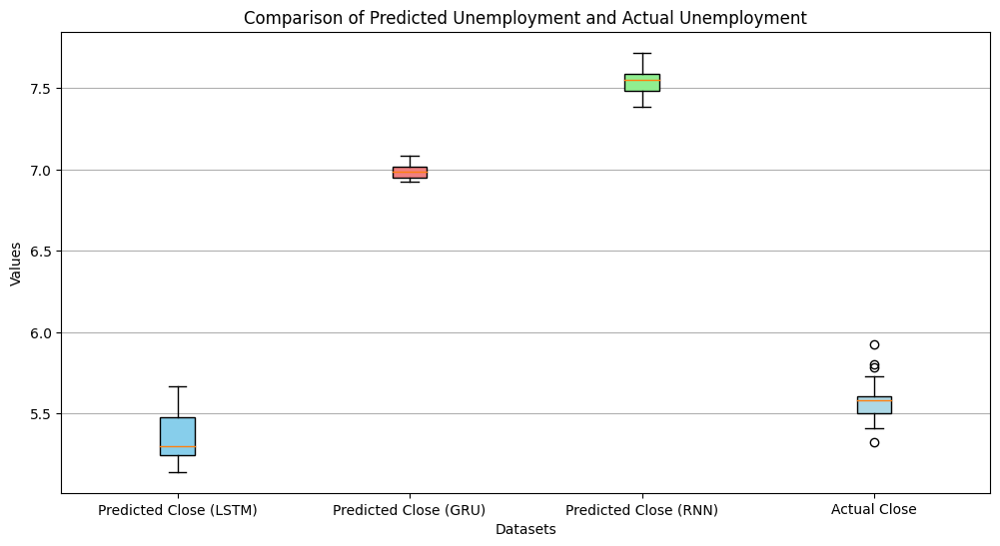

In [ ]:
plt.figure(figsize=(12, 6))

plt.boxplot(predictions_descaled, positions=[1], labels=['Predicted Close (LSTM)'], patch_artist=True, boxprops=dict(facecolor='skyblue'))
plt.boxplot(predictions_descaled_GRU, positions=[2], labels=['Predicted Close (GRU)'], patch_artist=True, boxprops=dict(facecolor='lightcoral'))
plt.boxplot(predictions_descaled_RNN, positions=[3], labels=['Predicted Close (RNN)'], patch_artist=True, boxprops=dict(facecolor='lightgreen'))
plt.boxplot(labels_descaled, positions=[4], labels=['Actual Close'], patch_artist=True, boxprops=dict(facecolor='lightblue'))

plt.xlabel('Datasets')
plt.ylabel('Values')
plt.title('Comparison of Predicted Unemployment and Actual Unemployment')
plt.grid(axis='y')

plt.show()

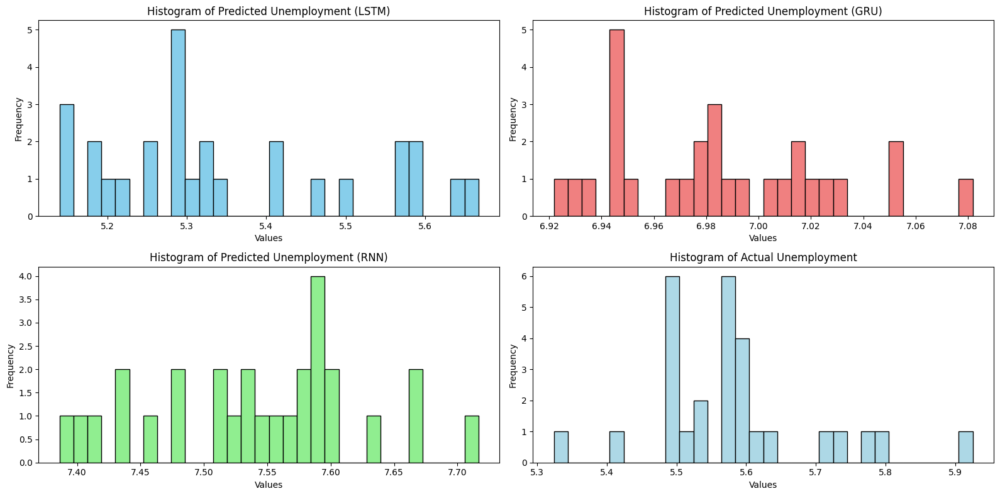

In [ ]:
plt.figure(figsize=(16, 8))

# Histogram for test_predictions
plt.subplot(2, 2, 1)
plt.hist(predictions_descaled, bins=30, color='skyblue', edgecolor='black')
plt.title('Histogram of Predicted Unemployment (LSTM)')
plt.xlabel('Values')
plt.ylabel('Frequency')

# Histogram for test_predictions_GRU
plt.subplot(2, 2, 2)
plt.hist(predictions_descaled_GRU, bins=30, color='lightcoral', edgecolor='black')
plt.title('Histogram of Predicted Unemployment (GRU)')
plt.xlabel('Values')
plt.ylabel('Frequency')

# Histogram for test_predictions_RNN
plt.subplot(2, 2, 3)
plt.hist(predictions_descaled_RNN, bins=30, color='lightgreen', edgecolor='black')
plt.title('Histogram of Predicted Unemployment (RNN)')
plt.xlabel('Values')
plt.ylabel('Frequency')

# Histogram for new_y_test
plt.subplot(2, 2, 4)
plt.hist(labels_descaled, bins=30, color='lightblue', edgecolor='black')
plt.title('Histogram of Actual Unemployment')
plt.xlabel('Values')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

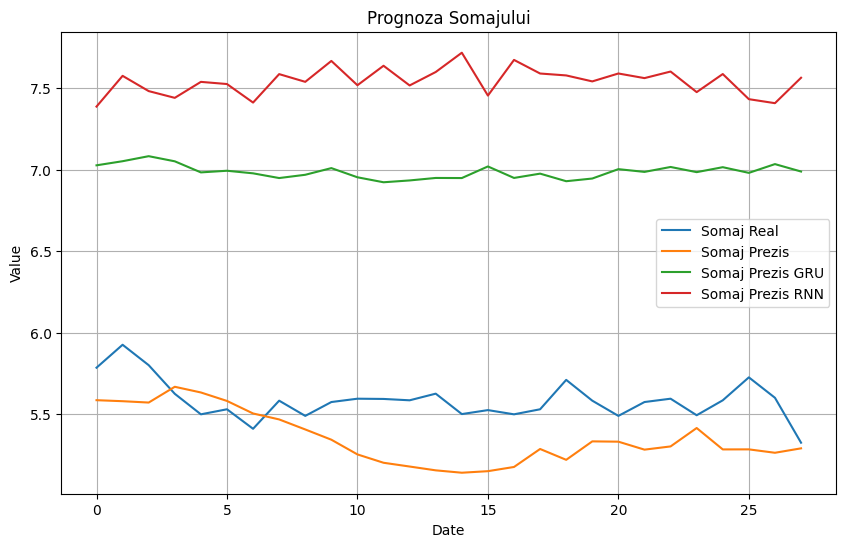

In [ ]:
plt.figure(figsize=(10, 6))

# Plot each series
true_line, = plt.plot(labels_descaled, label='Somaj Real')
pred_line, = plt.plot(predictions_descaled, label='Somaj Prezis')
gru_line, = plt.plot(predictions_descaled_GRU, label='Somaj Prezis GRU')
rnn_line, = plt.plot(predictions_descaled_RNN, label='Somaj Prezis RNN')

# Title and labels
plt.title('Prognoza Somajului', fontsize=12)
plt.xlabel('Date')
plt.ylabel('Value')

# Legend
plt.legend(fontsize=10)

# Grid
plt.grid(True)

# Show plot
plt.show()

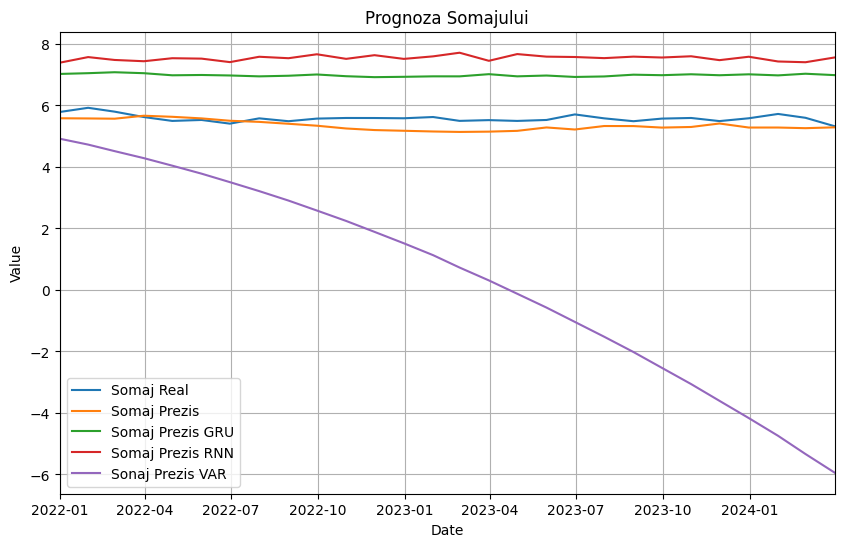

LSTM Model: MAE = 0.2541, MSE = 0.0826, RMSE = 0.2874
GRU Model: MAE = 1.4026, MSE = 1.9794, RMSE = 1.4069
RNN Model: MAE = 1.9586, MSE = 3.8608, RMSE = 1.9649


In [ ]:
num_predictions = len(predictions_descaled)

# Extract the last 'num_predictions' indices from df_results
index_for_predictions = df_results.index[-num_predictions:]

# Create DataFrames or Series for predictions with the correct index
predictions_series = pd.Series(predictions_descaled, index=index_for_predictions)
predictions_gru_series = pd.Series(predictions_descaled_GRU, index=index_for_predictions)
predictions_rnn_series = pd.Series(predictions_descaled_RNN, index=index_for_predictions)
labels_series = pd.Series(labels_descaled, index=index_for_predictions)

# Create the plot
plt.figure(figsize=(10, 6))

# Plot each series
plt.plot(labels_series, label='Somaj Real')
plt.plot(predictions_series, label='Somaj Prezis')
plt.plot(predictions_gru_series, label='Somaj Prezis GRU')
plt.plot(predictions_rnn_series, label='Somaj Prezis RNN')

# Include forecast column from df_results, aligned similarly
plt.plot(df_results['somaj_forecast'], label='Sonaj Prezis VAR')

# Set the x-axis to start from January 1, 2022
plt.xlim(pd.Timestamp('2022-01-01'), df_results.index.max())

# Set the y-axis to show only values higher than 2

# Title and labels
plt.title('Prognoza Somajului', fontsize=12)
plt.xlabel('Date')
plt.ylabel('Value')

# Legend
plt.legend(fontsize=10)

# Grid
plt.grid(True)

# Show plot
plt.show()

mae_lstm = mean_absolute_error(predictions_descaled, labels_descaled)
mse_lstm = mean_squared_error(predictions_descaled, labels_descaled)
rmse_lstm = np.sqrt(mse_lstm)


mae_gru = mean_absolute_error(predictions_descaled_GRU, labels_descaled)
mse_gru = mean_squared_error(predictions_descaled_GRU, labels_descaled)
rmse_gru = np.sqrt(mse_gru)

mae_rnn = mean_absolute_error(predictions_descaled_RNN, labels_descaled)
mse_rnn = mean_squared_error(predictions_descaled_RNN, labels_descaled)
rmse_rnn = np.sqrt(mse_rnn)

print(f"LSTM Model: MAE = {mae_lstm:.4f}, MSE = {mse_lstm:.4f}, RMSE = {rmse_lstm:.4f}")
print(f"GRU Model: MAE = {mae_gru:.4f}, MSE = {mse_gru:.4f}, RMSE = {rmse_gru:.4f}")
print(f"RNN Model: MAE = {mae_rnn:.4f}, MSE = {mse_rnn:.4f}, RMSE = {rmse_rnn:.4f}")


  0%|          | 0/183 [00:00<?, ?it/s]

  0%|          | 0/138 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1871), started 0:00:37 ago. (Use '!kill 1871' to kill it.)

<IPython.core.display.Javascript object>

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=0)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=0)` instead.
  rank_zero_deprecation(
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

Original Predictions (Scaled): [-0.14992232620716095, -0.10297751426696777, -0.0659480094909668, -0.028255032375454903, 0.01538629550486803]
Original Labels (Scaled): [0.6829192638397217, 0.7786749601364136, 0.8972567319869995, 1.1961697340011597, 1.5582298040390015]
Descaled Predictions: [1.89809213 2.1680248  2.38094445 2.59767907 2.8486167 ]
Descaled Labels: [ 6.68693127  7.23752652  7.91937171  9.63812147 11.71996688]
Original Predictions (Scaled): [-0.04226038604974747, -0.041678428649902344, -0.0639040619134903, -0.05764618515968323, -0.04685252904891968]
Original Labels (Scaled): [0.6829192638397217, 0.7786749601364136, 0.8972567319869995, 1.1961697340011597, 1.5582298040390015]
Descaled Predictions: [2.51714828 2.52049454 2.39269715 2.42867994 2.49074346]
Descaled Labels: [ 6.68693127  7.23752652  7.91937171  9.63812147 11.71996688]
Original Predictions (Scaled): [0.12569905817508698, 0.09414395689964294, 0.08994411677122116, 0.08589950948953629, 0.16504359245300293]
Original L

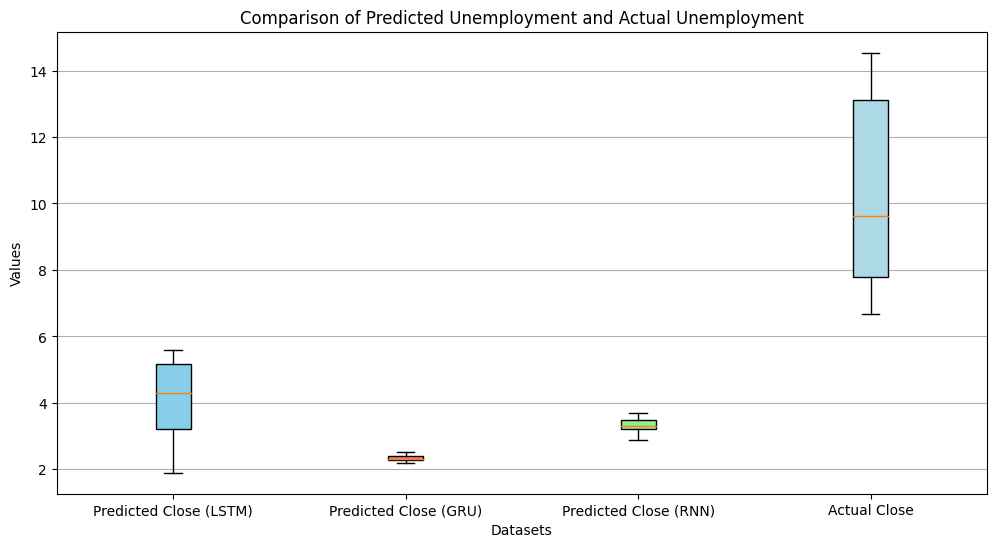

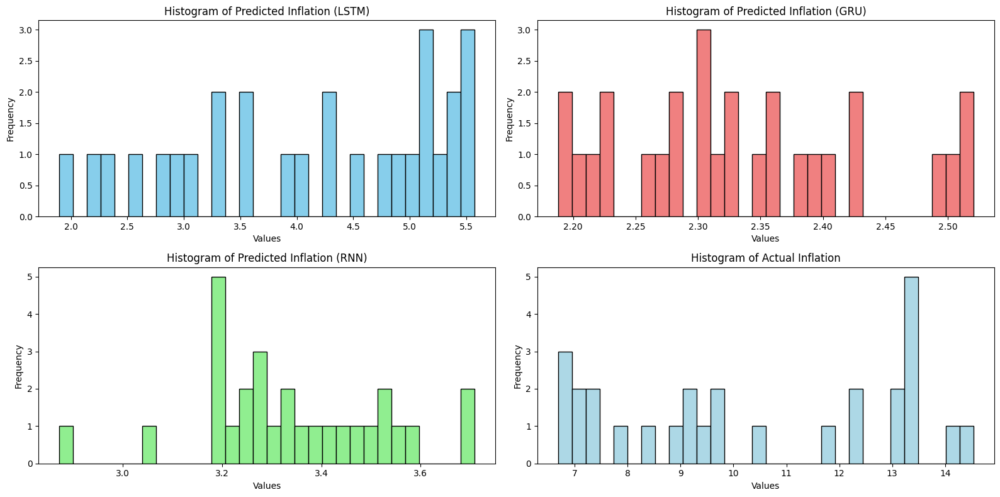

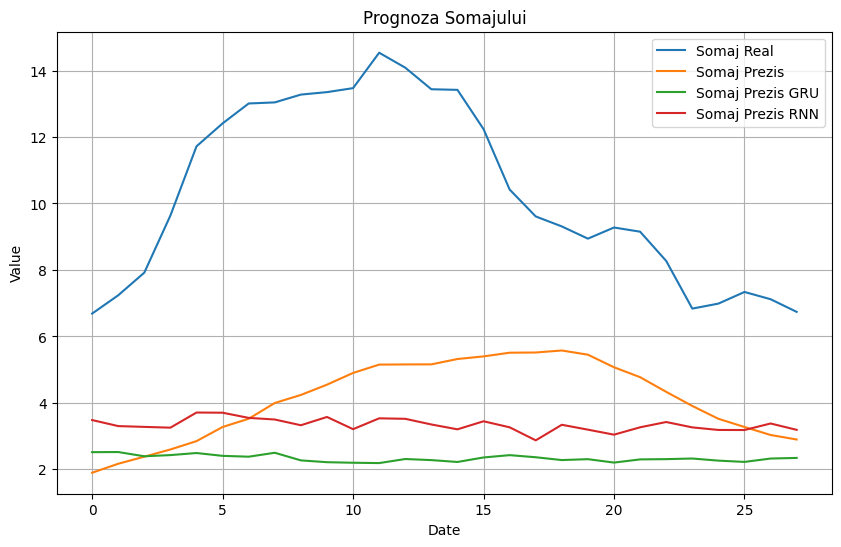

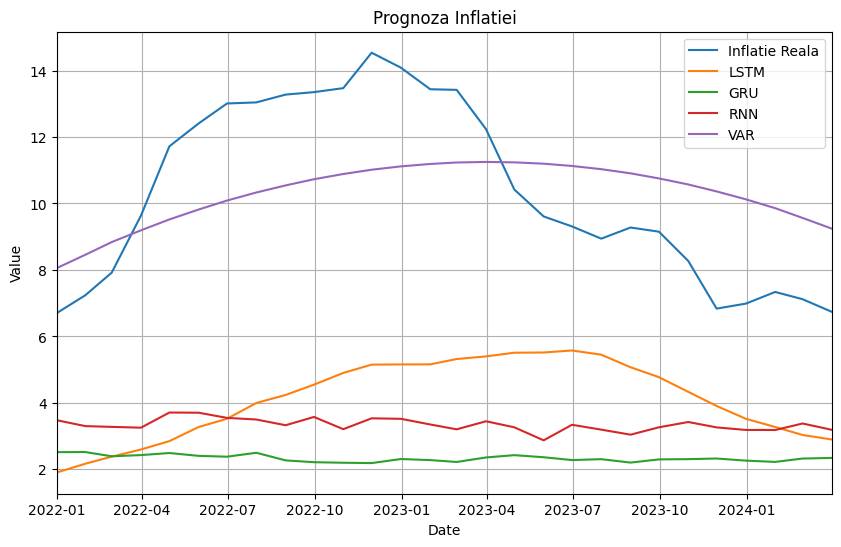

LSTM Model: MAE = 6.2165, MSE = 44.0074, RMSE = 6.6338
GRU Model: MAE = 8.0052, MSE = 71.2910, RMSE = 8.4434
RNN Model: MAE = 6.9977, MSE = 55.6407, RMSE = 7.4593


In [ ]:
rows = []

for _, row in tqdm(df.iterrows(), total=df.shape[0]):
  row_data = dict(
      inflatie = row.inflatie,
      somaj = row.somaj,
      rata_schimb = row.rata_schimb,
     # somaj_anterior = row.somaj_anterior
     # modficare_somaj = row.modificare_somaj]
       modificare_inflatie = row.modificare_inflatie
  )

  rows.append(row_data)

features_df = pd.DataFrame(rows)
features_df.index = df.index

features_df.shape

train_size = int(len(features_df) * 0.80)
train_size

train_df, test_df = features_df[:train_size], features_df[train_size +1:]
train_df.shape, test_df.shape

scaler = MinMaxScaler(feature_range=(-1,1))
scaler = scaler.fit(train_df)

train_df = pd.DataFrame(scaler.transform(train_df), index=train_df.index, columns=train_df.columns)

test_df = pd.DataFrame(scaler.transform(test_df), index=test_df.index, columns=test_df.columns)


train_sequences = create_sequences(train_df, "inflatie", SEQUENCE_LENGTH)
test_sequences = create_sequences(test_df, 'inflatie', SEQUENCE_LENGTH)


data_module = MacroDataModule(train_sequences, test_sequences, batch_size=BATCH_SIZE)
data_module.setup()

train_dataset = MacroDataset(train_sequences)

%load_ext tensorboard
%tensorboard --logdir ./lightning_logs

checkpoint_callback = ModelCheckpoint(
    dirpath='checkpoints',
    filename='best-checkpoint',
    save_top_k=1,
    verbose=True,
    monitor='val_loss',
    mode='min'
)

# Logger
logger = TensorBoardLogger('lightning_logs', name='Inflatie')

# EarlyStopping callback
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=2)

# Trainer configuration
trainer = pl.Trainer(
    logger=logger,
    callbacks=[checkpoint_callback, early_stopping_callback],  # No need to explicitly add a ProgressBar
    max_epochs=10,  # Replace N_EPOCHS with a specific number or define N_EPOCHS
    gpus=0,  # Use None or 0 if GPU is not available
    enable_progress_bar=True  # Default is True, showing the progress bar
)

tmodel = MacroUnemploymentPredictor('LSTM',n_features=train_df.shape[1])
model_GRU = MacroUnemploymentPredictor('GRU',n_features=train_df.shape[1])
model_RNN = MacroUnemploymentPredictor('RNN',n_features=train_df.shape[1])

test_dataset = MacroDataset(test_sequences)

predictions = []
labels = []

for item in tqdm(test_dataset):
  sequence = item['sequence']
  label = item['label']

  _, output = trained_model(sequence.unsqueeze(dim=0))
  predictions.append(output.item())
  labels.append(label.item())

  predictions_GRU = []
  labels_GRU = []

for item in tqdm(test_dataset):
  sequence = item['sequence']
  label = item['label']

  _, output = trained_GRU(sequence.unsqueeze(dim=0))
  predictions_GRU.append(output.item())
  labels_GRU.append(label.item())

  predictions_RNN = []
  labels_RNN = []

for item in tqdm(test_dataset):
  sequence = item['sequence']
  label = item['label']

  _, output = trained_RNN(sequence.unsqueeze(dim=0))
  predictions_RNN.append(output.item())
  labels_RNN.append(label.item())

predictions_array = np.array(predictions).reshape(-1, 1)
labels_array = np.array(labels).reshape(-1, 1)

# Inverse transform the predictions and labels
predictions_descaled = scaler.inverse_transform(np.hstack([predictions_array] * train_df.shape[1]))[:, 0]
labels_descaled = scaler.inverse_transform(np.hstack([labels_array] * train_df.shape[1]))[:, 0]

# Output the results
print("Original Predictions (Scaled):", predictions[:5])
print("Original Labels (Scaled):", labels[:5])
print("Descaled Predictions:", predictions_descaled[:5])
print("Descaled Labels:", labels_descaled[:5])

predictions_array_GRU = np.array(predictions_GRU).reshape(-1, 1)
labels_array_GRU = np.array(labels_GRU).reshape(-1, 1)

# Inverse transform the predictions and labels
predictions_descaled_GRU = scaler.inverse_transform(np.hstack([predictions_array_GRU] * train_df.shape[1]))[:, 0]
labels_descaled_GRU = scaler.inverse_transform(np.hstack([labels_array_GRU] * train_df.shape[1]))[:, 0]

# Output the results
print("Original Predictions (Scaled):", predictions_GRU[:5])
print("Original Labels (Scaled):", labels_GRU[:5])
print("Descaled Predictions:", predictions_descaled_GRU[:5])
print("Descaled Labels:", labels_descaled_GRU[:5])

predictions_array_RNN = np.array(predictions_RNN).reshape(-1, 1)
labels_array_RNN = np.array(labels_RNN).reshape(-1, 1)

# Inverse transform the predictions and labels
predictions_descaled_RNN = scaler.inverse_transform(np.hstack([predictions_array_RNN] * train_df.shape[1]))[:, 0]
labels_descaled_RNN = scaler.inverse_transform(np.hstack([labels_array_RNN] * train_df.shape[1]))[:, 0]

# Output the results
print("Original Predictions (Scaled):", predictions_RNN[:5])
print("Original Labels (Scaled):", labels_RNN[:5])
print("Descaled Predictions:", predictions_descaled_RNN[:5])
print("Descaled Labels:", labels_descaled_RNN[:5])


plt.figure(figsize=(12, 6))

plt.boxplot(predictions_descaled, positions=[1], labels=['Predicted Close (LSTM)'], patch_artist=True, boxprops=dict(facecolor='skyblue'))
plt.boxplot(predictions_descaled_GRU, positions=[2], labels=['Predicted Close (GRU)'], patch_artist=True, boxprops=dict(facecolor='lightcoral'))
plt.boxplot(predictions_descaled_RNN, positions=[3], labels=['Predicted Close (RNN)'], patch_artist=True, boxprops=dict(facecolor='lightgreen'))
plt.boxplot(labels_descaled, positions=[4], labels=['Actual Close'], patch_artist=True, boxprops=dict(facecolor='lightblue'))

plt.xlabel('Datasets')
plt.ylabel('Values')
plt.title('Comparison of Predicted Unemployment and Actual Unemployment')
plt.grid(axis='y')

plt.show()


plt.figure(figsize=(16, 8))

# Histogram for test_predictions
plt.subplot(2, 2, 1)
plt.hist(predictions_descaled, bins=30, color='skyblue', edgecolor='black')
plt.title('Histogram of Predicted Inflation (LSTM)')
plt.xlabel('Values')
plt.ylabel('Frequency')

# Histogram for test_predictions_GRU
plt.subplot(2, 2, 2)
plt.hist(predictions_descaled_GRU, bins=30, color='lightcoral', edgecolor='black')
plt.title('Histogram of Predicted Inflation (GRU)')
plt.xlabel('Values')
plt.ylabel('Frequency')

# Histogram for test_predictions_RNN
plt.subplot(2, 2, 3)
plt.hist(predictions_descaled_RNN, bins=30, color='lightgreen', edgecolor='black')
plt.title('Histogram of Predicted Inflation (RNN)')
plt.xlabel('Values')
plt.ylabel('Frequency')

# Histogram for new_y_test
plt.subplot(2, 2, 4)
plt.hist(labels_descaled, bins=30, color='lightblue', edgecolor='black')
plt.title('Histogram of Actual Inflation')
plt.xlabel('Values')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 6))

# Plot each series
true_line, = plt.plot(labels_descaled, label='Somaj Real')
pred_line, = plt.plot(predictions_descaled, label='Somaj Prezis')
gru_line, = plt.plot(predictions_descaled_GRU, label='Somaj Prezis GRU')
rnn_line, = plt.plot(predictions_descaled_RNN, label='Somaj Prezis RNN')

# Title and labels
plt.title('Prognoza Somajului', fontsize=12)
plt.xlabel('Date')
plt.ylabel('Value')

# Legend
plt.legend(fontsize=10)

# Grid
plt.grid(True)

# Show plot
plt.show()



num_predictions = len(predictions_descaled)

# Extract the last 'num_predictions' indices from df_results
index_for_predictions = df_results.index[-num_predictions:]

# Create DataFrames or Series for predictions with the correct index
predictions_series = pd.Series(predictions_descaled, index=index_for_predictions)
predictions_gru_series = pd.Series(predictions_descaled_GRU, index=index_for_predictions)
predictions_rnn_series = pd.Series(predictions_descaled_RNN, index=index_for_predictions)
labels_series = pd.Series(labels_descaled, index=index_for_predictions)

# Create the plot
plt.figure(figsize=(10, 6))

# Plot each series
plt.plot(labels_series, label='Inflatie Reala')
plt.plot(predictions_series, label='LSTM')
plt.plot(predictions_gru_series, label='GRU')
plt.plot(predictions_rnn_series, label='RNN')

# Include forecast column from df_results, aligned similarly
plt.plot(df_results['inflatie_forecast'], label='VAR')

# Set the x-axis to start from January 1, 2022
plt.xlim(pd.Timestamp('2022-01-01'), df_results.index.max())

# Set the y-axis to show only values higher than 2
#plt.ylim(2, 5.5)  # None means no upper limit, adjusts automatically based on data

# Title and labels
plt.title('Prognoza Inflatiei', fontsize=12)
plt.xlabel('Date')
plt.ylabel('Value')

# Legend
plt.legend(fontsize=10)

# Grid
plt.grid(True)

# Show plot
plt.show()

mae_lstm = mean_absolute_error(predictions_descaled, labels_descaled)
mse_lstm = mean_squared_error(predictions_descaled, labels_descaled)
rmse_lstm = np.sqrt(mse_lstm)


mae_gru = mean_absolute_error(predictions_descaled_GRU, labels_descaled)
mse_gru = mean_squared_error(predictions_descaled_GRU, labels_descaled)
rmse_gru = np.sqrt(mse_gru)

mae_rnn = mean_absolute_error(predictions_descaled_RNN, labels_descaled)
mse_rnn = mean_squared_error(predictions_descaled_RNN, labels_descaled)
rmse_rnn = np.sqrt(mse_rnn)

print(f"LSTM Model: MAE = {mae_lstm:.4f}, MSE = {mse_lstm:.4f}, RMSE = {rmse_lstm:.4f}")
print(f"GRU Model: MAE = {mae_gru:.4f}, MSE = {mse_gru:.4f}, RMSE = {rmse_gru:.4f}")
print(f"RNN Model: MAE = {mae_rnn:.4f}, MSE = {mse_rnn:.4f}, RMSE = {rmse_rnn:.4f}")


  0%|          | 0/183 [00:00<?, ?it/s]

  0%|          | 0/138 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

torch.Size([8, 4])
torch.Size([])
tensor(-0.9383)


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


torch.Size([5, 8, 4])
torch.Size([5])
tensor([-0.9383, -0.9385, -0.9603, -0.9447, -0.8892])
The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1871), started 0:00:42 ago. (Use '!kill 1871' to kill it.)

<IPython.core.display.Javascript object>

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:478: LightningDeprecationWarning: Setting `Trainer(gpus=0)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=0)` instead.
  rank_zero_deprecation(
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

Original Predictions (Scaled): [0.7437736988067627, 0.7661892175674438, 0.7578772902488708, 0.8116313219070435, 0.8170070052146912]
Original Labels (Scaled): [0.8705118894577026, 0.9071826934814453, 0.867546558380127, 1.0563271045684814, 1.1138370037078857]
Descaled Predictions: [4.25947386 4.27779578 4.2710018  4.31493907 4.31933303]
Descaled Labels: [4.36306664 4.39304049 4.36064285 4.51494758 4.5619548 ]
Original Predictions (Scaled): [-0.0200522318482399, -0.03755657374858856, -0.04137034714221954, -0.04707450047135353, -0.024778254330158234]
Original Labels (Scaled): [0.8705118894577026, 0.9071826934814453, 0.867546558380127, 1.0563271045684814, 1.1138370037078857]
Descaled Predictions: [3.63514074 3.6208331  3.61771582 3.61305338 3.6312778 ]
Descaled Labels: [4.36306664 4.39304049 4.36064285 4.51494758 4.5619548 ]
Original Predictions (Scaled): [0.12750229239463806, 0.12894220650196075, 0.12993782758712769, 0.14388005435466766, 0.1372460126876831]
Original Labels (Scaled): [0.870

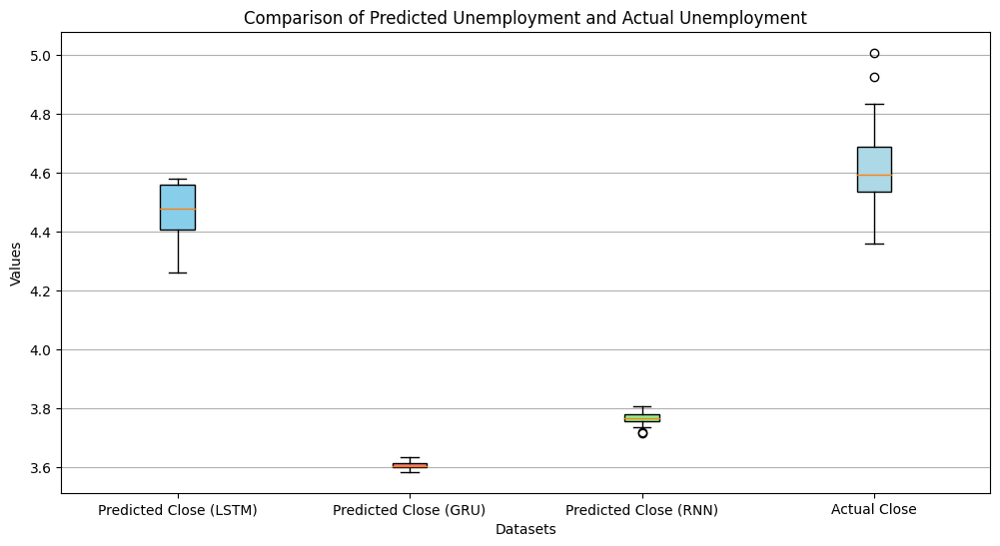

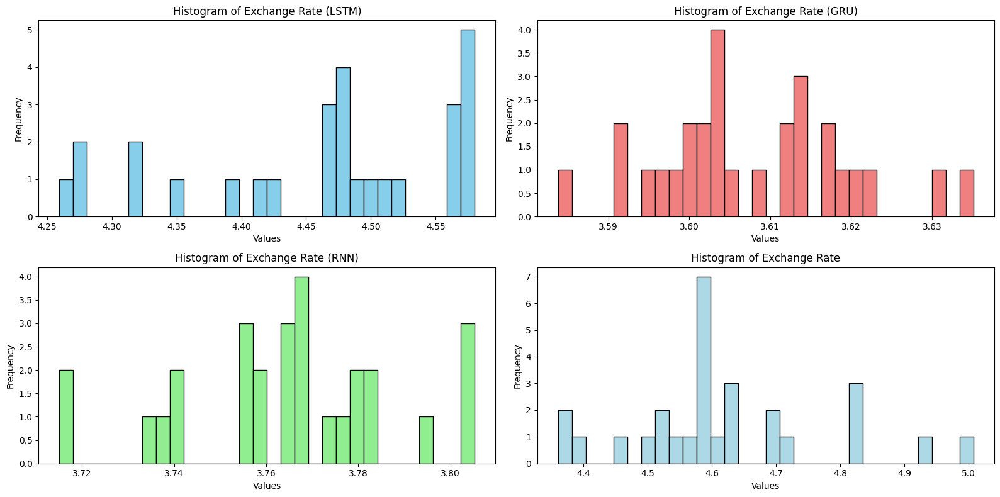

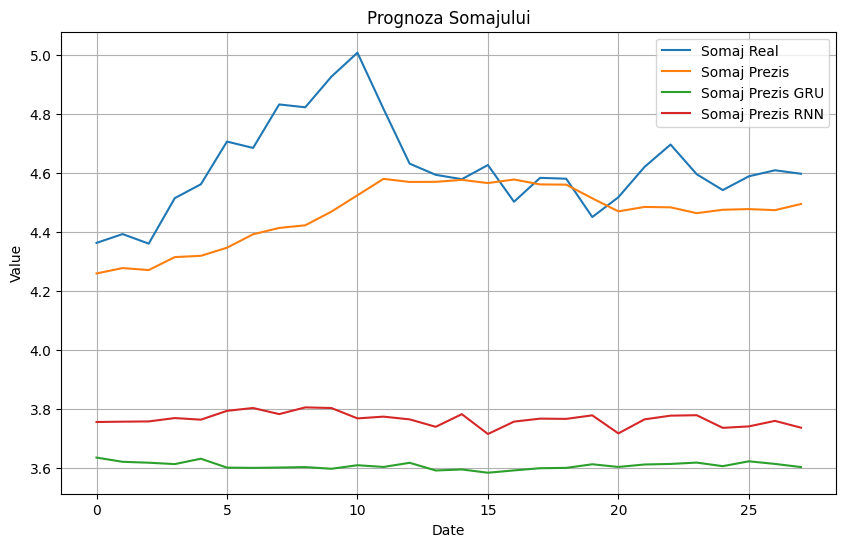

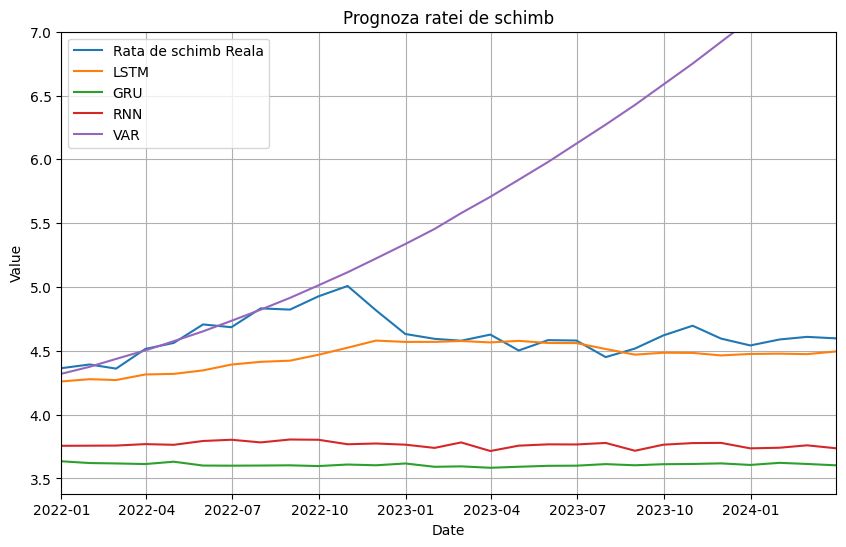

LSTM Model: MAE = 0.1670, MSE = 0.0475, RMSE = 0.2179
GRU Model: MAE = 1.0106, MSE = 1.0460, RMSE = 1.0228
RNN Model: MAE = 0.8535, MSE = 0.7491, RMSE = 0.8655


In [ ]:
rows = []

for _, row in tqdm(df.iterrows(), total=df.shape[0]):
  row_data = dict(
      rata_schimb = row.rata_schimb,
      inflatie = row.inflatie,
      somaj = row.somaj,
     # somaj_anterior = row.somaj_anterior
     # modficare_somaj = row.modificare_somaj]
       modificare_rata_schimb = row.modificare_rata_schimb
  )

  rows.append(row_data)

features_df = pd.DataFrame(rows)
features_df.index = df.index

features_df.shape

train_size = int(len(features_df) * 0.80)
train_size

train_df, test_df = features_df[:train_size], features_df[train_size +1:]
train_df.shape, test_df.shape

scaler = MinMaxScaler(feature_range=(-1,1))
scaler = scaler.fit(train_df)

train_df = pd.DataFrame(scaler.transform(train_df), index=train_df.index, columns=train_df.columns)

test_df = pd.DataFrame(scaler.transform(test_df), index=test_df.index, columns=test_df.columns)


train_sequences = create_sequences(train_df, "rata_schimb", SEQUENCE_LENGTH)
test_sequences = create_sequences(test_df, 'rata_schimb', SEQUENCE_LENGTH)


data_module = MacroDataModule(train_sequences, test_sequences, batch_size=BATCH_SIZE)
data_module.setup()

train_dataset = MacroDataset(train_sequences)

for item in train_dataset:
  print(item['sequence'].shape)
  print(item['label'].shape)
  print(item['label'])
  break

for item in data_module.train_dataloader():
  print(item['sequence'].shape)
  print(item['label'].shape)
  print(item['label'])
  break


%load_ext tensorboard
%tensorboard --logdir ./lightning_logs

checkpoint_callback = ModelCheckpoint(
    dirpath='checkpoints',
    filename='best-checkpoint',
    save_top_k=1,
    verbose=True,
    monitor='val_loss',
    mode='min'
)

# Logger
logger = TensorBoardLogger('lightning_logs', name='rata_schimb')

# EarlyStopping callback
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=2)

# Trainer configuration
trainer = pl.Trainer(
    logger=logger,
    callbacks=[checkpoint_callback, early_stopping_callback],  # No need to explicitly add a ProgressBar
    max_epochs=10,  # Replace N_EPOCHS with a specific number or define N_EPOCHS
    gpus=0,  # Use None or 0 if GPU is not available
    enable_progress_bar=True  # Default is True, showing the progress bar
)

tmodel = MacroUnemploymentPredictor('LSTM',n_features=train_df.shape[1])
model_GRU = MacroUnemploymentPredictor('GRU',n_features=train_df.shape[1])
model_RNN = MacroUnemploymentPredictor('RNN',n_features=train_df.shape[1])

test_dataset = MacroDataset(test_sequences)

predictions = []
labels = []

for item in tqdm(test_dataset):
  sequence = item['sequence']
  label = item['label']

  _, output = trained_model(sequence.unsqueeze(dim=0))
  predictions.append(output.item())
  labels.append(label.item())

  predictions_GRU = []
  labels_GRU = []

for item in tqdm(test_dataset):
  sequence = item['sequence']
  label = item['label']

  _, output = trained_GRU(sequence.unsqueeze(dim=0))
  predictions_GRU.append(output.item())
  labels_GRU.append(label.item())

  predictions_RNN = []
  labels_RNN = []

for item in tqdm(test_dataset):
  sequence = item['sequence']
  label = item['label']

  _, output = trained_RNN(sequence.unsqueeze(dim=0))
  predictions_RNN.append(output.item())
  labels_RNN.append(label.item())

predictions_array = np.array(predictions).reshape(-1, 1)
labels_array = np.array(labels).reshape(-1, 1)

# Inverse transform the predictions and labels
predictions_descaled = scaler.inverse_transform(np.hstack([predictions_array] * train_df.shape[1]))[:, 0]
labels_descaled = scaler.inverse_transform(np.hstack([labels_array] * train_df.shape[1]))[:, 0]

# Output the results
print("Original Predictions (Scaled):", predictions[:5])
print("Original Labels (Scaled):", labels[:5])
print("Descaled Predictions:", predictions_descaled[:5])
print("Descaled Labels:", labels_descaled[:5])

predictions_array_GRU = np.array(predictions_GRU).reshape(-1, 1)
labels_array_GRU = np.array(labels_GRU).reshape(-1, 1)

# Inverse transform the predictions and labels
predictions_descaled_GRU = scaler.inverse_transform(np.hstack([predictions_array_GRU] * train_df.shape[1]))[:, 0]
labels_descaled_GRU = scaler.inverse_transform(np.hstack([labels_array_GRU] * train_df.shape[1]))[:, 0]

# Output the results
print("Original Predictions (Scaled):", predictions_GRU[:5])
print("Original Labels (Scaled):", labels_GRU[:5])
print("Descaled Predictions:", predictions_descaled_GRU[:5])
print("Descaled Labels:", labels_descaled_GRU[:5])

predictions_array_RNN = np.array(predictions_RNN).reshape(-1, 1)
labels_array_RNN = np.array(labels_RNN).reshape(-1, 1)

# Inverse transform the predictions and labels
predictions_descaled_RNN = scaler.inverse_transform(np.hstack([predictions_array_RNN] * train_df.shape[1]))[:, 0]
labels_descaled_RNN = scaler.inverse_transform(np.hstack([labels_array_RNN] * train_df.shape[1]))[:, 0]

# Output the results
print("Original Predictions (Scaled):", predictions_RNN[:5])
print("Original Labels (Scaled):", labels_RNN[:5])
print("Descaled Predictions:", predictions_descaled_RNN[:5])
print("Descaled Labels:", labels_descaled_RNN[:5])


plt.figure(figsize=(12, 6))

plt.boxplot(predictions_descaled, positions=[1], labels=['Predicted Close (LSTM)'], patch_artist=True, boxprops=dict(facecolor='skyblue'))
plt.boxplot(predictions_descaled_GRU, positions=[2], labels=['Predicted Close (GRU)'], patch_artist=True, boxprops=dict(facecolor='lightcoral'))
plt.boxplot(predictions_descaled_RNN, positions=[3], labels=['Predicted Close (RNN)'], patch_artist=True, boxprops=dict(facecolor='lightgreen'))
plt.boxplot(labels_descaled, positions=[4], labels=['Actual Close'], patch_artist=True, boxprops=dict(facecolor='lightblue'))

plt.xlabel('Datasets')
plt.ylabel('Values')
plt.title('Comparison of Predicted Unemployment and Actual Unemployment')
plt.grid(axis='y')

plt.show()


plt.figure(figsize=(16, 8))

# Histogram for test_predictions
plt.subplot(2, 2, 1)
plt.hist(predictions_descaled, bins=30, color='skyblue', edgecolor='black')
plt.title('Histogram of Exchange Rate (LSTM)')
plt.xlabel('Values')
plt.ylabel('Frequency')

# Histogram for test_predictions_GRU
plt.subplot(2, 2, 2)
plt.hist(predictions_descaled_GRU, bins=30, color='lightcoral', edgecolor='black')
plt.title('Histogram of Exchange Rate (GRU)')
plt.xlabel('Values')
plt.ylabel('Frequency')

# Histogram for test_predictions_RNN
plt.subplot(2, 2, 3)
plt.hist(predictions_descaled_RNN, bins=30, color='lightgreen', edgecolor='black')
plt.title('Histogram of Exchange Rate (RNN)')
plt.xlabel('Values')
plt.ylabel('Frequency')

# Histogram for new_y_test
plt.subplot(2, 2, 4)
plt.hist(labels_descaled, bins=30, color='lightblue', edgecolor='black')
plt.title('Histogram of Exchange Rate')
plt.xlabel('Values')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 6))

# Plot each series
true_line, = plt.plot(labels_descaled, label='Somaj Real')
pred_line, = plt.plot(predictions_descaled, label='Somaj Prezis')
gru_line, = plt.plot(predictions_descaled_GRU, label='Somaj Prezis GRU')
rnn_line, = plt.plot(predictions_descaled_RNN, label='Somaj Prezis RNN')

# Title and labels
plt.title('Prognoza Somajului', fontsize=12)
plt.xlabel('Date')
plt.ylabel('Value')

# Legend
plt.legend(fontsize=10)

# Grid
plt.grid(True)

# Show plot
plt.show()

num_predictions = len(predictions_descaled)

# Extract the last 'num_predictions' indices from df_results
index_for_predictions = df_results.index[-num_predictions:]

# Create DataFrames or Series for predictions with the correct index
predictions_series = pd.Series(predictions_descaled, index=index_for_predictions)
predictions_gru_series = pd.Series(predictions_descaled_GRU, index=index_for_predictions)
predictions_rnn_series = pd.Series(predictions_descaled_RNN, index=index_for_predictions)
labels_series = pd.Series(labels_descaled, index=index_for_predictions)

# Create the plot
plt.figure(figsize=(10, 6))

# Plot each series
plt.plot(labels_series, label='Rata de schimb Reala')
plt.plot(predictions_series, label='LSTM')
plt.plot(predictions_gru_series, label='GRU')
plt.plot(predictions_rnn_series, label='RNN')

# Include forecast column from df_results, aligned similarly
plt.plot(df_results['rata_schimb_forecast'], label='VAR')

# Set the x-axis to start from January 1, 2022
plt.xlim(pd.Timestamp('2022-01-01'), df_results.index.max())

# Set the y-axis to show only values higher than 2
plt.ylim(None,7 )  # None means no upper limit, adjusts automatically based on data

# Title and labels
plt.title('Prognoza ratei de schimb', fontsize=12)
plt.xlabel('Date')
plt.ylabel('Value')

# Legend
plt.legend(fontsize=10)

# Grid
plt.grid(True)

# Show plot
plt.show()

mae_lstm = mean_absolute_error(predictions_descaled, labels_descaled)
mse_lstm = mean_squared_error(predictions_descaled, labels_descaled)
rmse_lstm = np.sqrt(mse_lstm)


mae_gru = mean_absolute_error(predictions_descaled_GRU, labels_descaled)
mse_gru = mean_squared_error(predictions_descaled_GRU, labels_descaled)
rmse_gru = np.sqrt(mse_gru)

mae_rnn = mean_absolute_error(predictions_descaled_RNN, labels_descaled)
mse_rnn = mean_squared_error(predictions_descaled_RNN, labels_descaled)
rmse_rnn = np.sqrt(mse_rnn)

print(f"LSTM Model: MAE = {mae_lstm:.4f}, MSE = {mse_lstm:.4f}, RMSE = {rmse_lstm:.4f}")
print(f"GRU Model: MAE = {mae_gru:.4f}, MSE = {mse_gru:.4f}, RMSE = {rmse_gru:.4f}")
print(f"RNN Model: MAE = {mae_rnn:.4f}, MSE = {mse_rnn:.4f}, RMSE = {rmse_rnn:.4f}")


In [ ]:
# Number of rows to consider for the latest 20%
num_somaj = int(len(somaj) * 0.20)
num_inflatie = int(len(inflatie) * 0.20)
num_rata_schimb = int(len(rata_schimb) * 0.20)

# Extract the latest 20% observations
somaj_latest = somaj[-num_somaj:]
inflatie_latest = inflatie[-num_inflatie:]
rata_schimb_latest = rata_schimb[-num_rata_schimb:]

# Function to identify outliers using IQR
def find_outliers(df):
    outliers = pd.DataFrame()
    for column in df.columns:
        if df[column].dtype != 'object':
            Q1 = df[column].quantile(0.25)
            Q3 = df[column].quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR
            outliers_in_column = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
            if not outliers_in_column.empty:
                outliers = pd.concat([outliers, outliers_in_column])
    return outliers.drop_duplicates()

# Find outliers in the latest 20% observations for each dataframe
somaj_outliers = find_outliers(somaj_latest)
inflatie_outliers = find_outliers(inflatie_latest)
rata_schimb_outliers = find_outliers(rata_schimb_latest)

# Display the outliers
print("Somaj Outliers:\n", somaj_outliers)
print("\nInflatie Outliers:\n", inflatie_outliers)
print("\nRata Schimb Outliers:\n", rata_schimb_outliers)

Somaj Outliers:
             Rata Somajului
T                         
2021-05-31             5.3
2021-06-30             5.1
2021-10-31             5.8
2022-01-31             5.9

Inflatie Outliers:
 Empty DataFrame
Columns: []
Index: []

Rata Schimb Outliers:
 Empty DataFrame
Columns: []
Index: []
